In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import cv2


# Task: 1

In [2]:
# defining the kernels

def gaussian_kernel(u, cov_matrix):
    # print(u.shape)
    kernel_values = []
    for data in u:
        n = len(data)
        constant_term = (2 * np.pi) ** (n / 2)
        det_cov = np.linalg.det(cov_matrix)
        inv_cov = np.linalg.inv(cov_matrix)
        
        exponent_term = -0.5 * np.dot(np.dot(data.T, inv_cov), data)
        kernel_value = (1 / (constant_term * np.sqrt(det_cov))) * np.exp(exponent_term)
        kernel_values.append(kernel_value)
    kernel_values = np.array(kernel_values)
    return kernel_values

def box_kernel(u):

    kernel_values = []
    for data in u:  
        if np.all(np.abs(data) <= 1):
            V = 2**len(data)  
            kernel_values.append(1/V)
        else:
            kernel_values.append(0)
    
    kernel_values = np.array(kernel_values)
    return kernel_values    

def triangular_kernel(u):
    kernel_values = []
    for data in u:
        if np.sum(np.abs(data)) <= 1:
            kernel_values.append(1 - np.sum(np.abs(data)))
        else:
            kernel_values.append(0)
    kernel_values = np.array(kernel_values)
    return kernel_values

def density(x, h, xi, K):
    density_values = np.sum(K((x - xi) / h)) / (xi.shape[0] * h)
    return density_values

In [69]:
# KDE class implementation
class KDE:
    def __init__(self, kernel='gaussian', bandwidths = np.linspace(0.01, 2, 100)):
        self.kernel = kernel
        self.bandwidths = bandwidths
        self.data = None
        self.dim = None
        self.kernel_func = None
        if self.kernel == 'gaussian':
            self.kernel_func = gaussian_kernel
        elif self.kernel == 'box':
            self.kernel_func = box_kernel
        elif self.kernel == 'triangular':
            self.kernel_func = triangular_kernel

    def fit(self, data):
        self.data = data
        self.dim = data.shape[1]

    def evaluate_bandwidth(self, h_values):
        n = len(self.data)
        likelihoods = []

        if self.dim != 2:
            # finding the best bandwidth in both dimension using pseudo likelihood method
            for h in h_values:
                likelihood = 0
                for i in range(n):
                    # print(self.data.shape)
                    data_without_i = np.delete(self.data, i, axis = 0)
                    # print(data_without_i.shape)
                    if(self.kernel == 'gaussian'):
                        k = self.kernel_func((self.data[i]-data_without_i)/h, np.eye(self.dim)*h) 
                        # print(k.shape)
                        likelihood += np.log(np.sum(k, axis = 0) / ((n-1) * h**self.dim) + 1e-10)
                    else:
                        likelihood += np.log(np.sum(self.kernel_func((self.data[i]-data_without_i) / h), axis = 0) / ((n-1) * h**self.dim) + 1e-10)
                likelihoods.append(likelihood)
            likelihoods = np.array(likelihoods)
        if self.dim == 2:
            best_h = [0, 0]
            best_likelihood = -np.inf

            # finding the best bandwidth in both dimension using pseudo likelihood method
            for h1 in h_values:
                for h2 in h_values:
                    h = np.array([h1, h2])
                    likelihood = 0
                    for i in range(n):
                        data_without_i = np.delete(self.data, i, axis = 0)
                        if(self.kernel == 'gaussian'):
                            k = self.kernel_func((self.data[i]-data_without_i)/h, np.diag(h)) 
                            likelihood += np.log(np.sum(k, axis = 0) / ((n-1) * h1 * h2) + 1e-10)
                        else:
                            likelihood += np.log(np.sum(self.kernel_func((self.data[i]-data_without_i) / h), axis = 0) / ((n-1) * h1 * h2) + 1e-10)
                    # print(likelihood)
                    if likelihood > best_likelihood:
                        best_likelihood = likelihood
                        best_h = h

            return best_h
        return h_values[np.argmax(likelihoods)]

    def visualize(self, plot_points=1000, show_data=True):
        if self.dim == 1:
            x_plot = np.linspace(np.min(self.data) * 0.95, np.max(self.data) *1.05, plot_points)
            best_h = self.evaluate_bandwidth(self.bandwidths)
            # print(best_h)
            n = self.data.shape[0]
            kde = np.zeros_like(x_plot)

            for i in range(len(x_plot)):
                if(self.kernel == 'gaussian'):
                    k = self.kernel_func((x_plot[i] - self.data)/ best_h, np.eye(self.dim)*best_h)
                    # print(k.shape)
                    kde[i] = np.sum(k, axis = 0) / (n * best_h**self.dim)
                else:
                    kde[i] = np.sum(self.kernel_func((x_plot[i] - self.data) / best_h)) / (n * best_h**self.dim)

            self.density_values = kde
            self.x_plot = x_plot

            if show_data == False:
                return
            # plt.figure(figsize=(10, 6))
            plt.scatter(self.data, np.zeros_like(self.data), alpha=0.5, label='Data')
            plt.plot(x_plot, kde, label=self.kernel.capitalize() + ' Kernel')
            plt.title('Kernel Density Estimation')
            plt.xlabel('X-axis')
            plt.ylabel('Density')
            plt.legend()
            plt.show()

        elif self.dim == 2:
            best_h = self.evaluate_bandwidth(self.bandwidths)
            print(best_h)
            x_min, x_max = np.min(self.data[:, 0]), np.max(self.data[:, 0])
            y_min, y_max = np.min(self.data[:, 1]), np.max(self.data[:, 1])
            
            # Create the mesh grid
            x_vals = np.linspace(x_min * 0.95, x_max * 1.05, plot_points)
            y_vals = np.linspace(y_min * 0.95, y_max * 1.05, plot_points)
            x, y = np.meshgrid(x_vals, y_vals)

            positions = np.column_stack([x.ravel(), y.ravel()])

            # Calculate KDE values
            kde_values = np.zeros_like(x)
            for i in range(len(positions)):
                if(self.kernel == 'gaussian'):
                    kde_values.ravel()[i] = np.sum(self.kernel_func((positions[i] - self.data)/ best_h, np.eye(self.dim)*best_h)) / (self.data.shape[0] * best_h[0] * best_h[1])
                else:
                    kde_values.ravel()[i] = np.sum(self.kernel_func((positions[i] - self.data) / best_h)) / (self.data.shape[0] * best_h[0] * best_h[1])

            if show_data == False:
                return
            plt.figure(figsize=(8, 6))
            plt.contourf(x, y, kde_values, cmap='viridis', levels=100)  # Adjust levels as needed
            plt.colorbar(label='Density')
            plt.scatter(self.data[:, 0], self.data[:, 1], alpha=0.5, label='Data')
            plt.title('2D Kernel Density Estimation')
            plt.xlabel('X-axis')
            plt.ylabel('Y-axis')
            plt.legend()
            plt.show()


### Estimating the pdf for different distribution generated randomly

[50.         36.14141414]


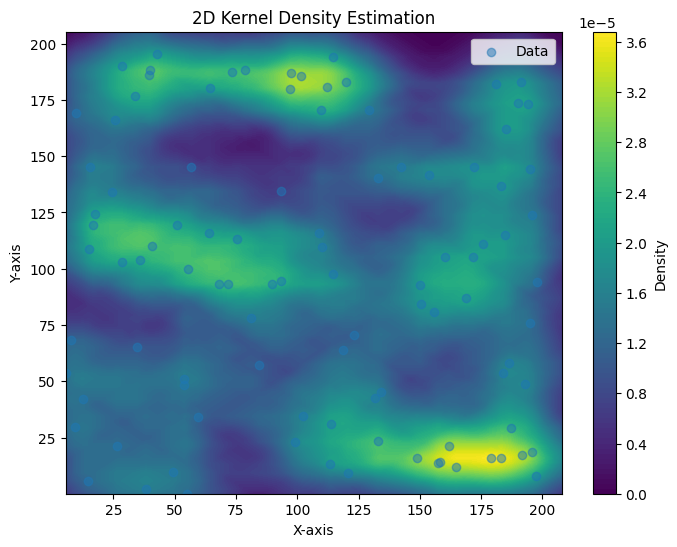

In [33]:
kde_ = KDE(kernel='triangular', bandwidths=np.linspace(1, 50, 100))
kde_.fit(data=np.random.random((100, 2))*200)

kde_.visualize()

6.326530612244898


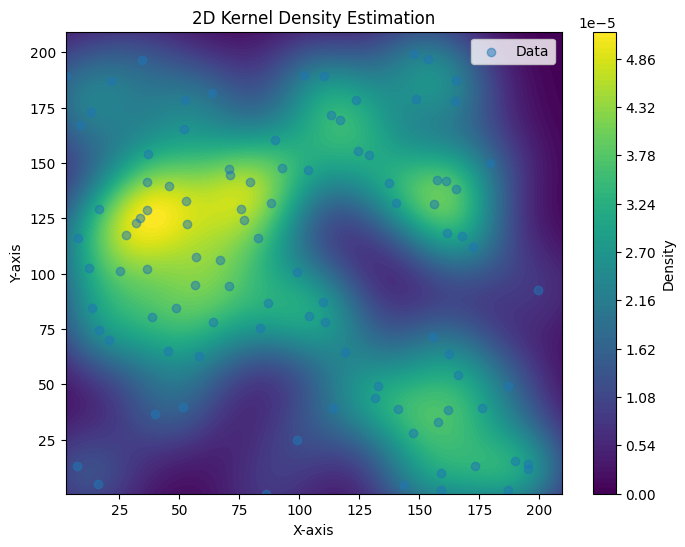

In [5]:
kde_ = KDE(kernel='gaussian', bandwidths=np.linspace(1, 10, 50))
kde_.fit(data=np.random.random((100, 2))*200)

kde_.visualize()

9.26530612244898


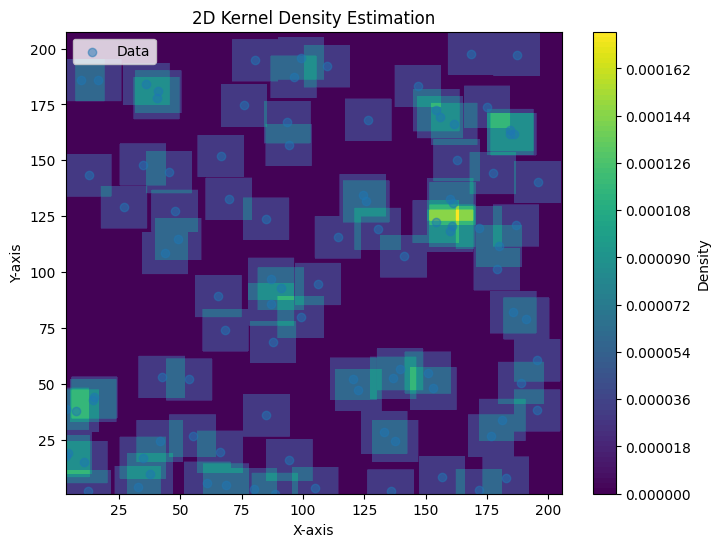

In [6]:
kde_ = KDE(kernel='box', bandwidths=np.linspace(1, 50, 100))
kde_.fit(data=np.random.random((100, 2))*200)

kde_.visualize()

10.8989898989899


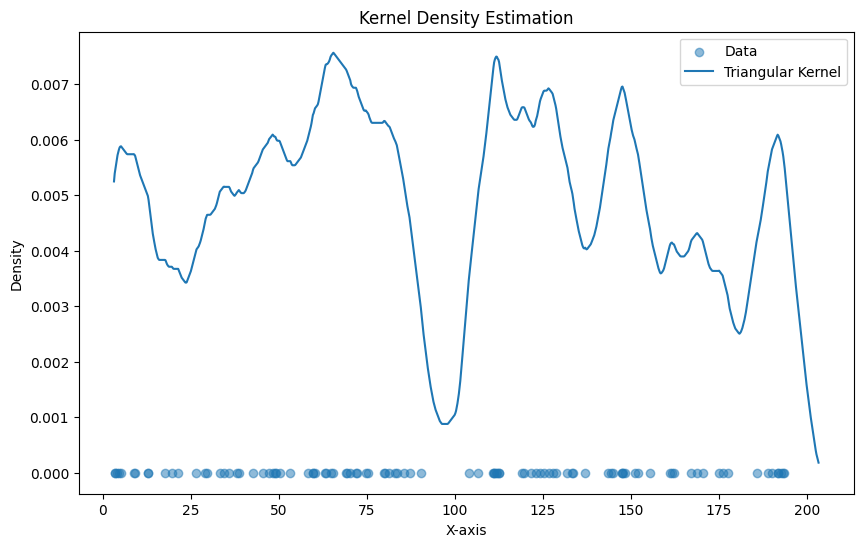

In [10]:
kde_ = KDE(kernel='triangular', bandwidths=np.linspace(1, 50, 100))
kde_.fit(data=np.random.random((100, 1))*200)

kde_.visualize()

3.5714285714285716


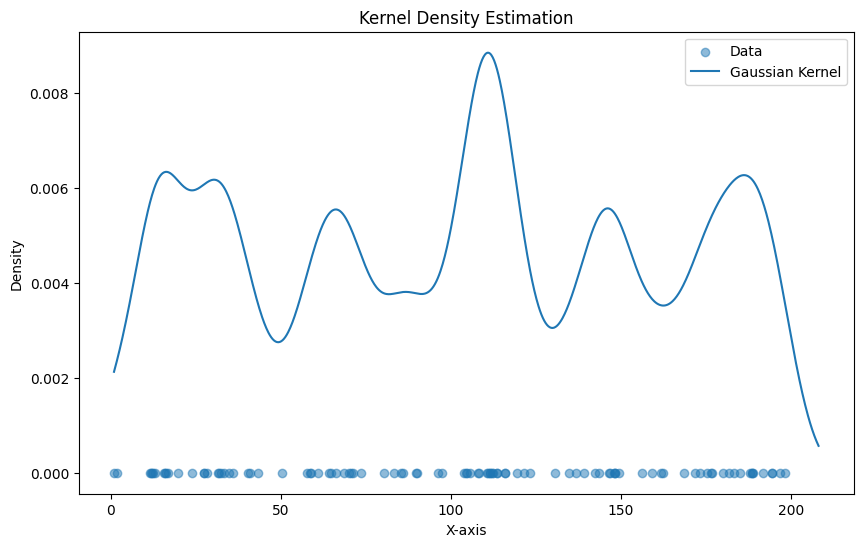

In [8]:
kde_ = KDE(kernel='gaussian', bandwidths=np.linspace(1, 10, 50))
kde_.fit(data=np.random.random((100, 1))*200)

kde_.visualize()

15.353535353535355


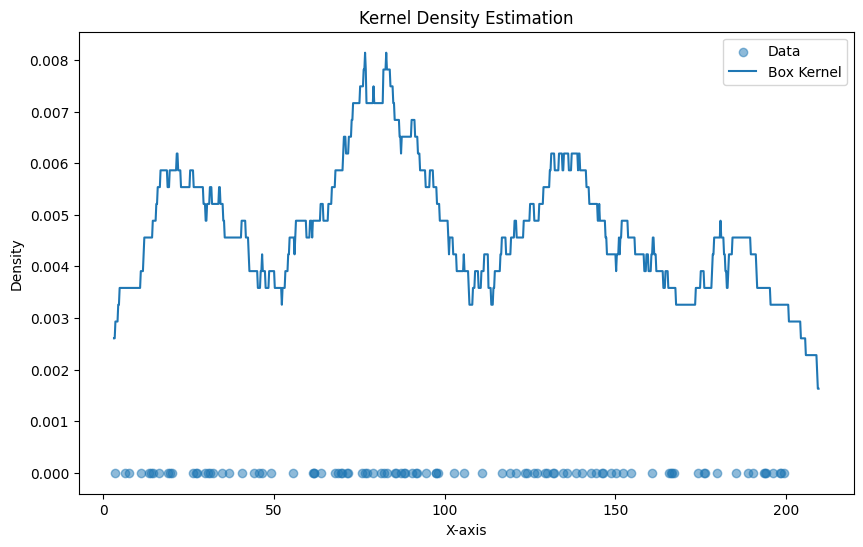

In [12]:
kde_ = KDE(kernel='box', bandwidths=np.linspace(1, 50, 100))
kde_.fit(data=np.random.random((100, 1))*200)

kde_.visualize()

# Task: 2

## Taking 4 images and implementing the task for 4 different sets of hyperparameter (bandwidth) 

### Work Flow for the task

- Extract Bounding Box Information
    - Obtain the Top-Left and Bottom-Right coordinates from the input DataFrame.

- Calculate Coordinates of Four Points for Each Bounding Box
    - For every bounding box:
        - Determine the bottom-center, top-center, left-center, and right-center coordinates.

- Create Arrays for Minimum Distances
    - Generate arrays for vertical_distances and horizontal_distances.
    - Store the minimum vertical and horizontal distances between each box.

- Apply Kernel Density Estimation (KDE)
    - Apply KDE separately on the vertical_distances and horizontal_distances arrays.
    - Obtain distributions for minimum vertical and horizontal distances.

- Determine Vertical Threshold
    - Utilize the vertical distance distribution from KDE to establish the vertical threshold.
    - Set the vertical threshold at the distance where the probability density function (pdf) is at least half the maximum value of the pdf.

- Establish Horizontal Threshold
    - Use the horizontal distance distribution from KDE to determine the horizontal threshold.
    - Set the horizontal threshold similarly to the vertical threshold calculation.

- Connect Boxes Based on Thresholds
    - Connect boxes that have distances within their respective thresholds.
    - Establish connections between boxes meeting the vertical and horizontal thresholds.

### IMAGE: 68

In [4]:
# loading the information of Top-Left and Bottom-Right of all boxes for a specific image
df = pd.read_csv('./Part-4/CSV/TLBR_68.csv')

In [5]:
# loading the image
img = cv2.imread('./Part-4/images/68.jpg')

(-0.5, 2474.5, 3499.5, -0.5)

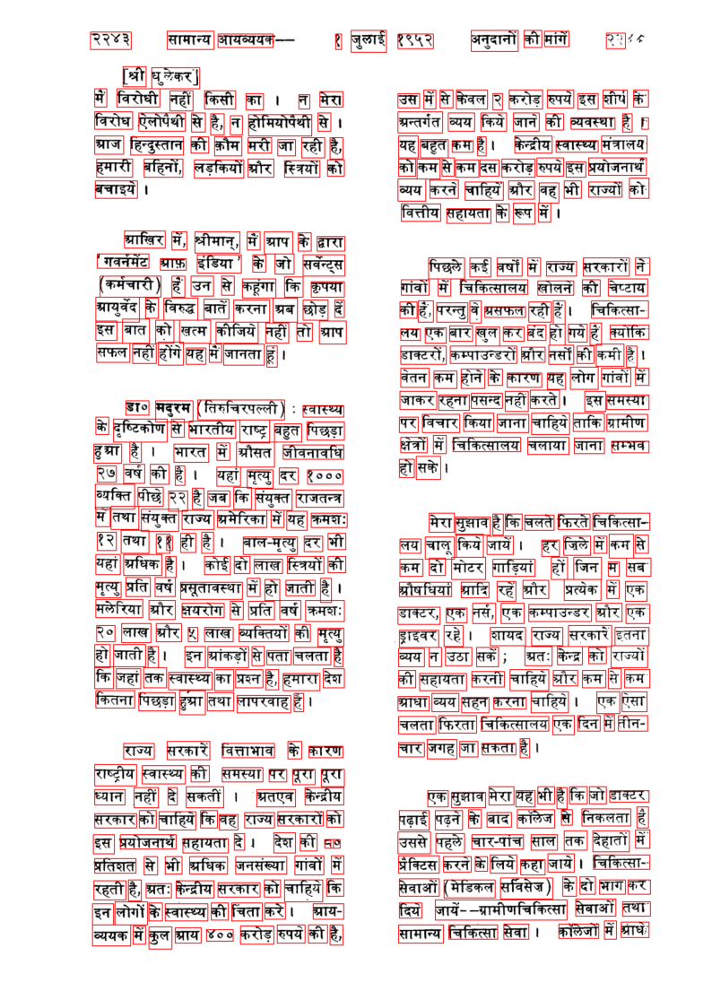

In [6]:
# function to visualize the bounding boxes
def visualize_bboxes(img):
  # plt.imshow(img)
  img_2 = img.copy()
  for index, rows in df.iterrows():
    # print('hello')
    top_left = (int(rows['Top-Left'].split(',')[0][1:]),int(rows['Top-Left'].split(',')[1][:-1]))
    bottom_right = (int(rows['Bottom-Right'].split(',')[0][1:]),int(rows['Bottom-Right'].split(',')[1][:-1]))
    # print(top_left)
    cv2.rectangle(img_2, top_left, bottom_right, (255, 0, 0), 2)

  return img_2

img_2 = visualize_bboxes(img)
plt.figure(figsize=(10, 20))
plt.imshow(img_2)
plt.axis("off")

In [7]:
# to calculate the 4 points of the bounding boxes (bottom-center, top-center, left-center, right-center)
df['Bottom'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Bottom-Right'].split(',')[1][:-1])], axis=1)
df['Top'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Top-Left'].split(',')[1][:-1])], axis=1)
df['Left'] = df.apply(lambda row: [int(row['Top-Left'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Right'] = df.apply(lambda row: [int(row['Bottom-Right'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Center'] = df.apply(lambda row: [(int(row['Top-Left'].split(',')[0][1:]) + int(row['Bottom-Right'].split(',')[0][1:]))/2.0, (int(row['Top-Left'].split(',')[1][:-1]) + int(row['Bottom-Right'].split(',')[1][:-1]))/2.0], axis=1)

In [8]:
df

,Unnamed: 0,Top-Left,Bottom-Right,Id,Bottom,Top,Left,Right,Center
0,0,"[290, 85]","[435, 147]",0,"[362.5, 147]","[362.5, 85]","[290, 116.0]","[435, 116.0]","[362.5, 116.0]"
1,1,"[563, 82]","[730, 147]",1,"[646.5, 147]","[646.5, 82]","[563, 114.5]","[730, 114.5]","[646.5, 114.5]"
2,2,"[744, 92]","[940, 140]",2,"[842.0, 140]","[842.0, 92]","[744, 116.0]","[940, 116.0]","[842.0, 116.0]"
3,3,"[1163, 92]","[1184, 147]",3,"[1173.5, 147]","[1173.5, 92]","[1163, 119.5]","[1184, 119.5]","[1173.5, 119.5]"
4,4,"[1218, 79]","[1344, 157]",4,"[1281.0, 157]","[1281.0, 79]","[1218, 118.0]","[1344, 118.0]","[1281.0, 118.0]"
...,...,...,...,...,...,...,...,...,...
493,493,"[1566, 3264]","[1740, 3315]",493,"[1653.0, 3315]","[1653.0, 3264]","[1566, 3289.5]","[1740, 3289.5]","[1653.0, 3289.5]"
494,494,"[1762, 3261]","[1851, 3315]",494,"[1806.5, 3315]","[1806.5, 3261]","[1762, 3288.0]","[1851, 3288.0]","[1806.5, 3288.0]"
495,495,"[1958, 3261]","[2100, 3312]",495,"[2029.0, 3312]","[2029.0, 3261]","[1958, 3286.5]","[2100, 3286.5]","[2029.0, 3286.5]"
496,496,"[2120, 3250]","[2163, 3315]",496,"[2141.5, 3315]","[2141.5, 3250]","[2120, 3282.5]","[2163, 3282.5]","[2141.5, 3282.5]"


In [9]:

points = df['Center'].values

In [10]:
points = np.array([np.array(sublist) for sublist in points])
points.shape

(498, 2)

[200.          92.85714286]


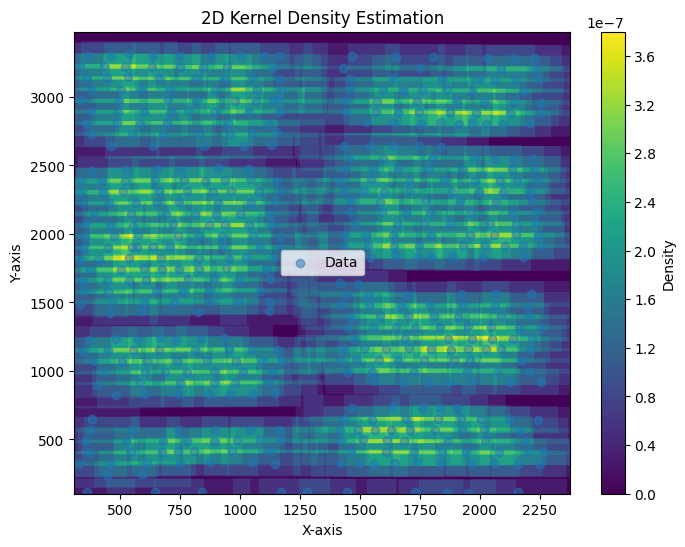

In [35]:
kde_ = KDE(kernel='box', bandwidths=np.linspace(50, 200, 15))
kde_.fit(data=points)

kde_.visualize()

In [11]:
def euclidean_distance(p1, p2):
    # print(p1, p2)
    return np.sqrt((p1[0]-p2[0])**2 + (p1[1]-p2[1])**2)

def find_distance(df):

    distance_horizontal = [] 
    distance_vertical = []

    for i in range(len(df)):
        mn_h = 1e5
        mn_v = 1e5
        for j in range(len(df)):
            if(i==j):
                continue
            dist1 = euclidean_distance((df['Bottom'].iloc[i]), (df['Top'].iloc[j]))
            dist2 = euclidean_distance((df['Top'].iloc[i]), (df['Bottom'].iloc[j]))
            dist3 = euclidean_distance((df['Left'].iloc[i]), (df['Right'].iloc[j]))
            dist4 = euclidean_distance((df['Right'].iloc[i]), (df['Left'].iloc[j]))
            # print(dist1, dist2, dist3, dist4)

            if min(dist1, dist2)<mn_v:
                mn_v = min(dist1, dist2)
            if min(dist3, dist4)<mn_h:
                mn_h = min(dist3, dist4)
        
        distance_vertical.append(mn_v)
        distance_horizontal.append(mn_h)

    return (distance_horizontal, distance_vertical)

In [16]:
def euclidean_distance(p1, p2):

    return np.sqrt((p1[0]-p2[0])**2 + (p1[1]-p2[1])**2)


# function to find the 4 adjacent boxes for each box based on the threshold
def find_connections(df, vertical_threshold, horizontal_threshold):
    # image_with_boxes = image.copy()
    df['Bottom_Box'] = df.apply(lambda row: [-1, 0], axis=1)
    df['Right_Box'] = df.apply(lambda row: [-1, 0], axis=1)
    df['Top_Box'] = df.apply(lambda row: [-1, 0], axis=1)
    df['Left_Box'] = df.apply(lambda row: [-1, 0], axis=1)

    for i in range(len(df)):
        for j in range(len(df)):
            if(i==j):
                continue
            dist1 = euclidean_distance((df['Bottom'].iloc[i]), (df['Top'].iloc[j]))
            dist2 = euclidean_distance((df['Top'].iloc[i]), (df['Bottom'].iloc[j]))
            dist3 = euclidean_distance((df['Left'].iloc[i]), (df['Right'].iloc[j]))
            dist4 = euclidean_distance((df['Right'].iloc[i]), (df['Left'].iloc[j]))
            # print(dist1, dist2, dist3, dist4)
            if(dist1<vertical_threshold):
                df['Bottom_Box'].iloc[i] = [j, df['Id'].iloc[j]]
            if(dist2<vertical_threshold):
                df['Top_Box'].iloc[i] = [j, df['Id'].iloc[j]]
            if(dist3<horizontal_threshold):
                df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
            if(dist4<horizontal_threshold):
                df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
    return df
            

In [17]:
# function to visualize the connections between the boxes
def make_connections(image):

  image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  image_with_boxes = image_rgb.copy()
  
  for index, row in df.iterrows():
      left = int(row['Left'][0])
      right = int(row['Right'][0])
      top = int(row['Top'][1])
      bottom = int(row['Bottom'][1])
      box_id = int(row['Id'])

      width = right - left
      height = bottom - top

      top_left = (left, top)
      bottom_right = (right, bottom)

      cv2.rectangle(image_with_boxes, top_left, bottom_right, (255, 0, 0), 2)

      label_position = (left, top - 10)
      cv2.putText(image_with_boxes, str(box_id), label_position, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 1)

      top_adjacent_id = int(row['Top_Box'][1])
      bottom_adjacent_id = int(row['Bottom_Box'][1])
      left_adjacent_id = int(row['Left_Box'][1])
      right_adjacent_id = int(row['Right_Box'][1])

      if top_adjacent_id != 0:
          top_adjacent_row = df[df['Id'] == top_adjacent_id].iloc[0]
          top_adjacent_center = int(top_adjacent_row['Bottom'][0]) , int(top_adjacent_row['Bottom'][1])
          cv2.line(image_with_boxes, (int(left) + width // 2, int(top)), top_adjacent_center, (0, 255, 0), 8)

      if bottom_adjacent_id != 0:
          bottom_adjacent_row = df[df['Id'] == bottom_adjacent_id].iloc[0]
          bottom_adjacent_center = int(bottom_adjacent_row['Top'][0]) , int(bottom_adjacent_row['Top'][1])
          cv2.line(image_with_boxes, (int(left) + width // 2, int(bottom)), (int(bottom_adjacent_center[0]), int(bottom_adjacent_center[1])), (0, 255, 0), 8)

      if left_adjacent_id != 0:
          left_adjacent_row = df[df['Id'] == left_adjacent_id].iloc[0]
          left_adjacent_center = int(left_adjacent_row['Right'][0]) , int(left_adjacent_row['Right'][1])
          cv2.line(image_with_boxes, (int(left), int(top) + height // 2), (int(left_adjacent_center[0]), int(left_adjacent_center[1])), (0, 255, 0), 8)

      if right_adjacent_id != 0:
          right_adjacent_row = df[df['Id'] == right_adjacent_id].iloc[0]
          right_adjacent_center = int(right_adjacent_row['Left'][0]) , int(right_adjacent_row['Left'][1])
          cv2.line(image_with_boxes, (int(right), int(top) + height // 2), (int(right_adjacent_center[0]), int(right_adjacent_center[1])), (0, 255, 0), 8)

  return image_with_boxes

In [12]:
distance_vertical = []
distance_horizontal = []

distance_horizontal, distance_vertical = find_distance(df)

In [13]:
distance_horizontal = np.array(distance_horizontal)
distance_vertical = np.array(distance_vertical)

print(distance_vertical.shape, distance_horizontal.shape)
print(distance_horizontal[0], distance_vertical[0])

(498,) (498,)
128.0087887607722 104.21732101718985


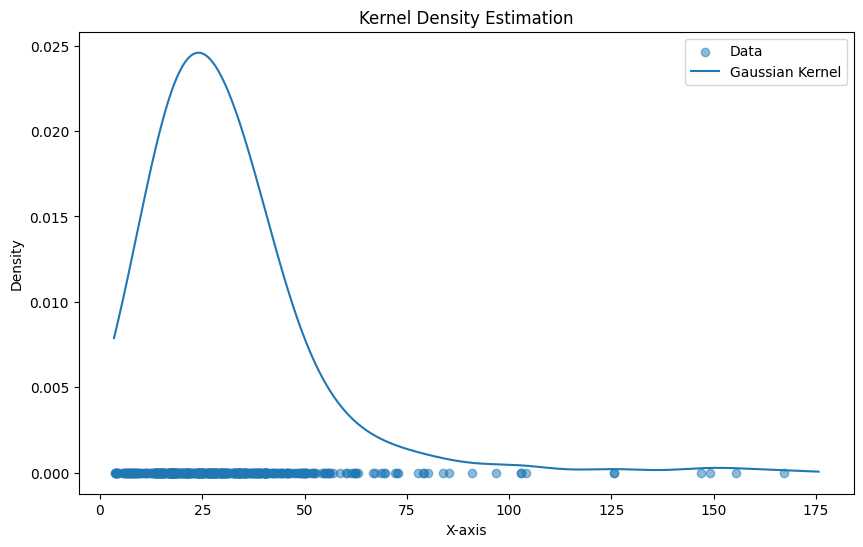

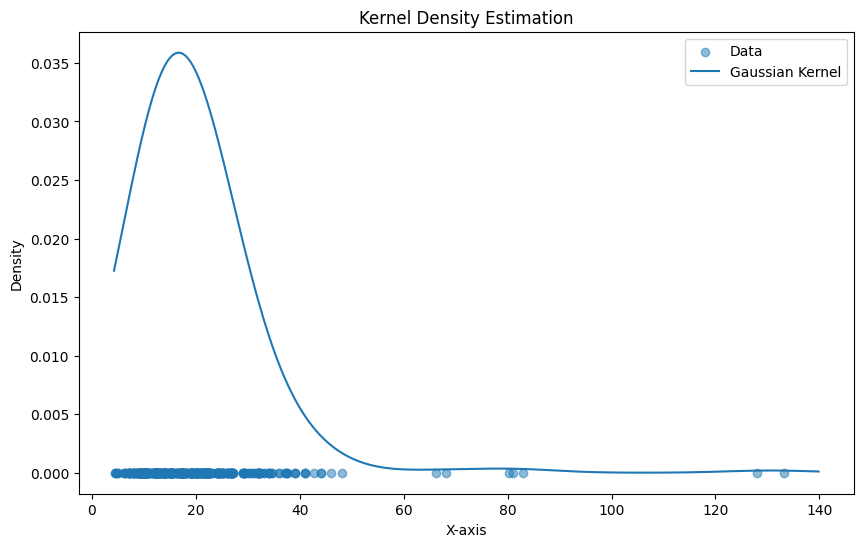

vertical threshold:  43.938959303172545
horizontal threshold:  30.037321995260275


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

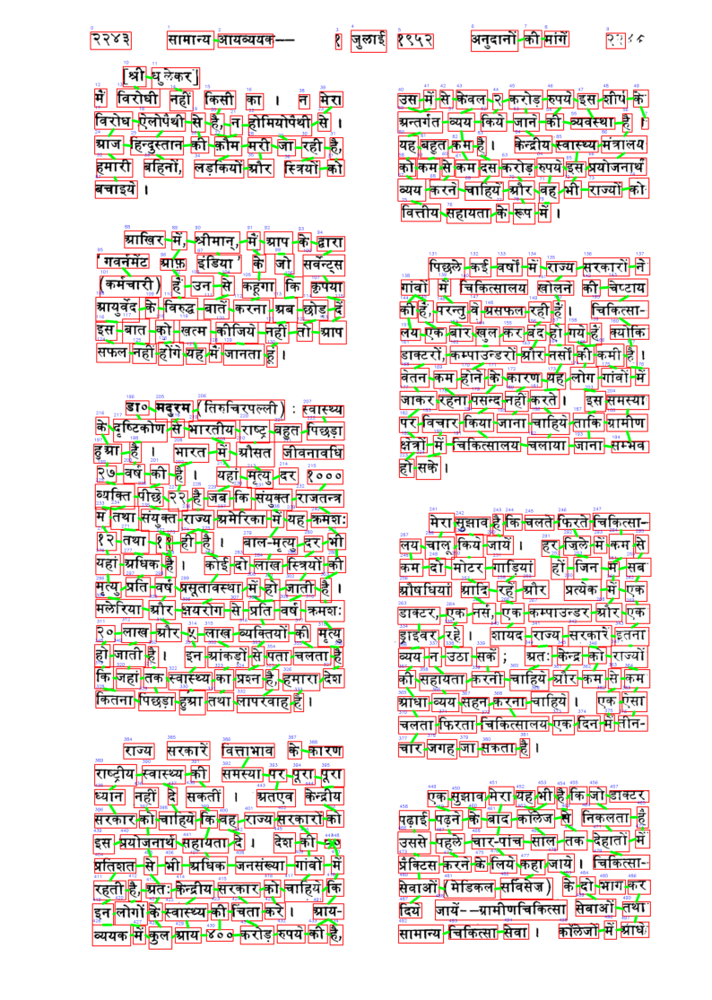

In [23]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(4, 5, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(4, 5, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img))
plt.axis("off")
plt.show()

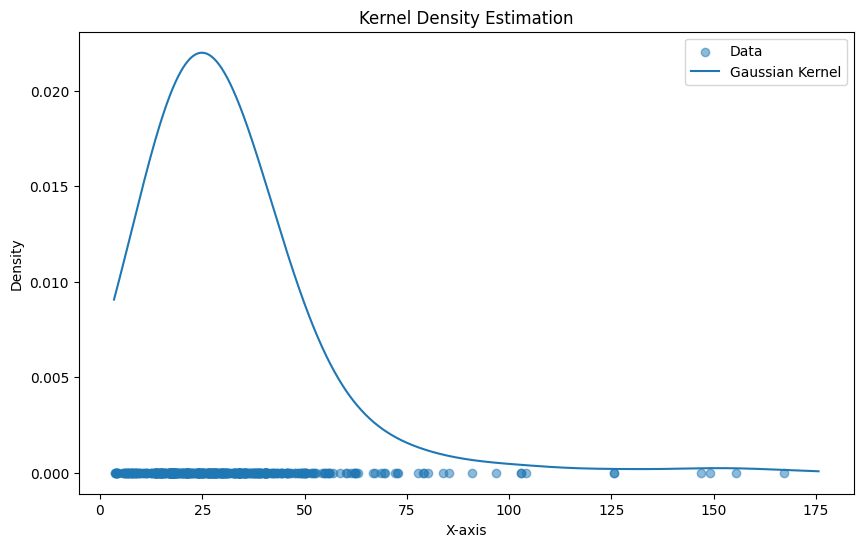

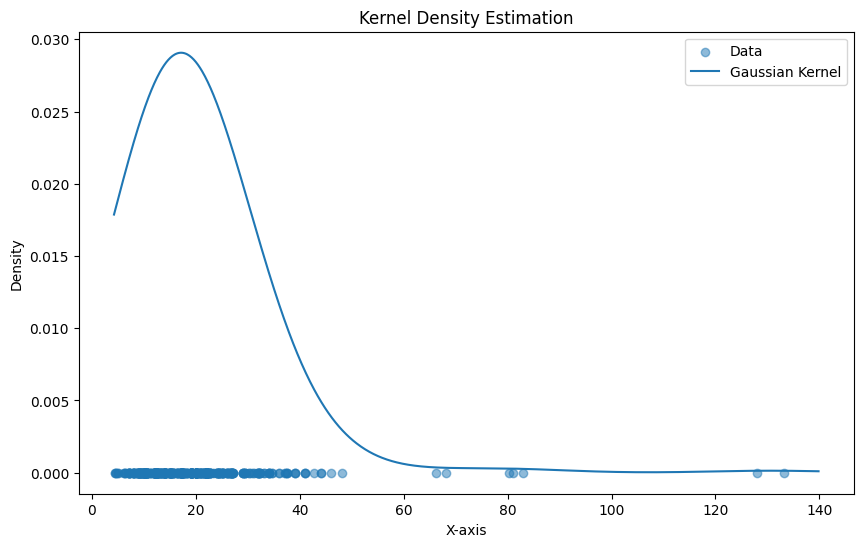

vertical threshold:  46.52493923454372
horizontal threshold:  33.430584210788


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

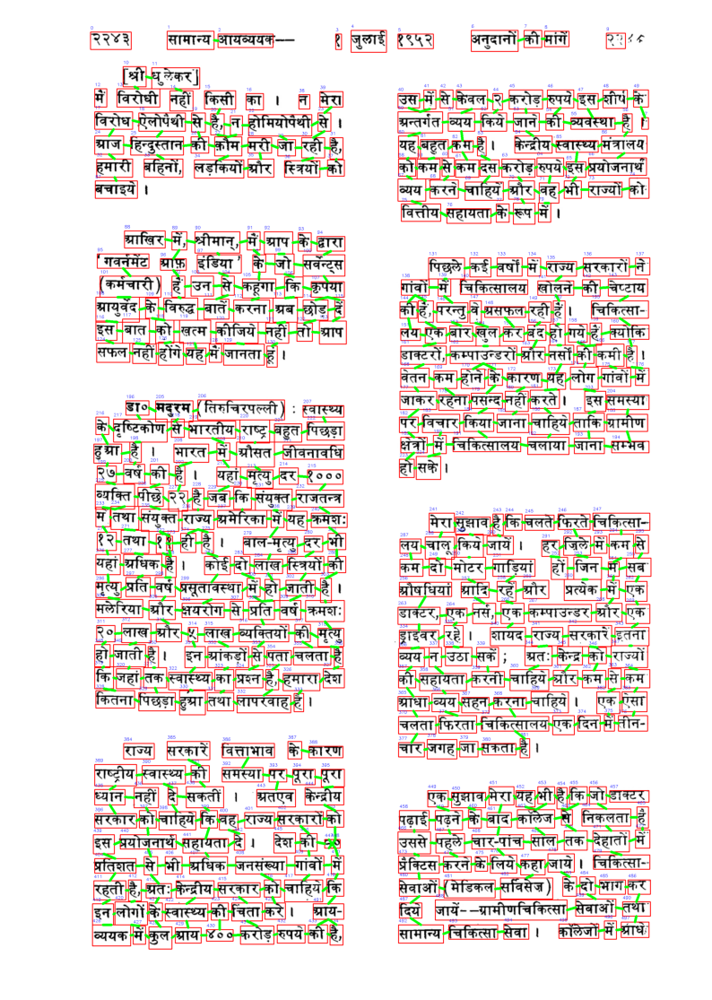

In [24]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(5, 6, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(5, 6, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img))
plt.axis("off")
plt.show()

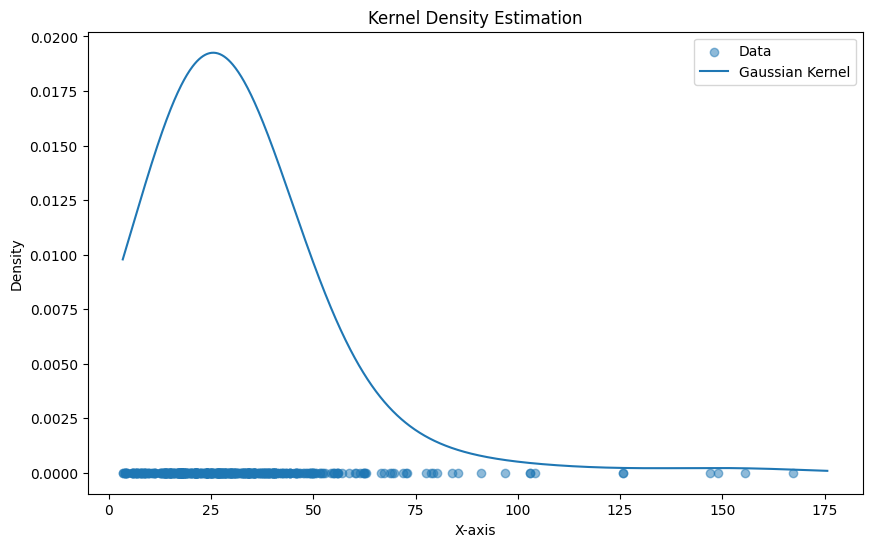

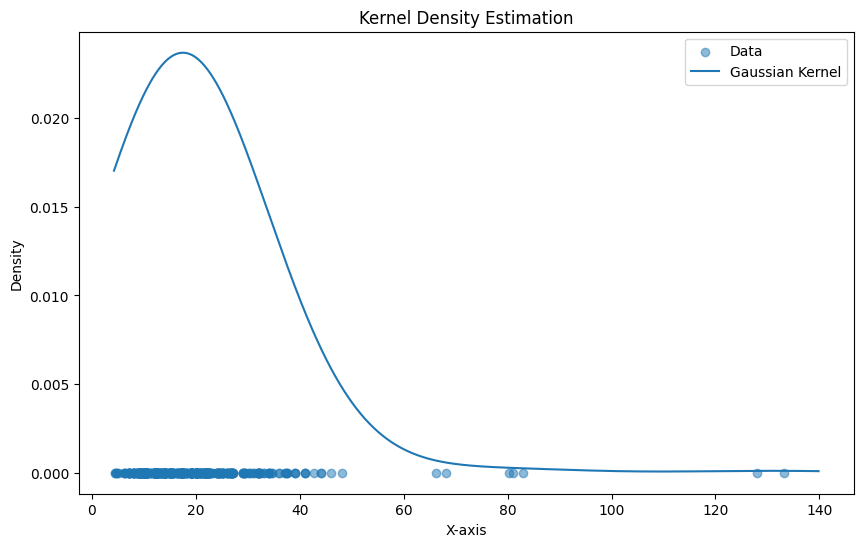

vertical threshold:  49.97291247637196
horizontal threshold:  37.23103789217904


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

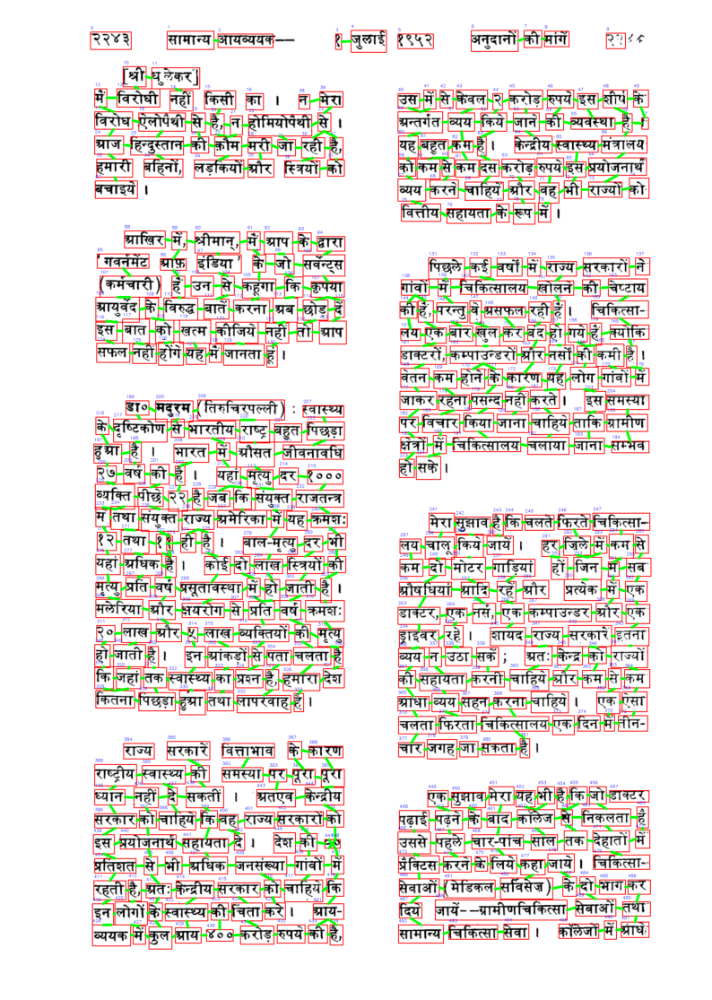

In [25]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(6, 7, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(6, 7, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img))
plt.axis("off")
plt.show()

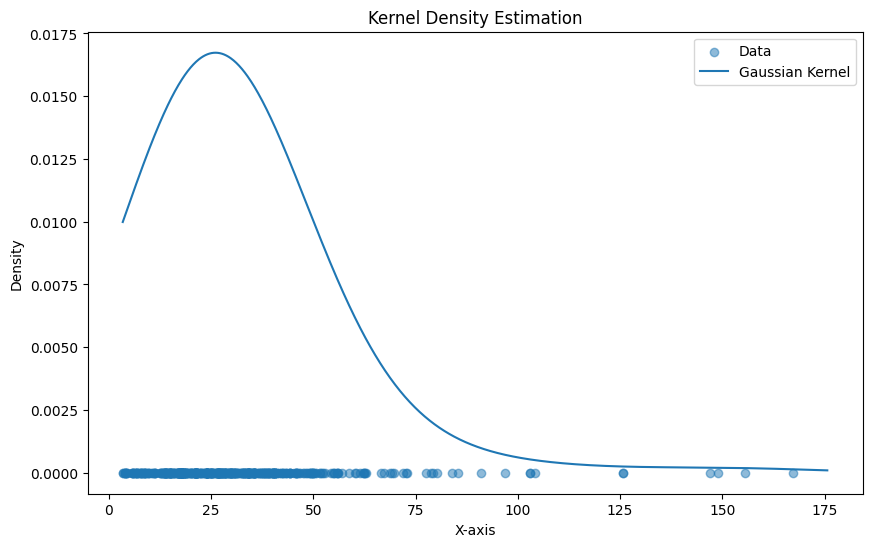

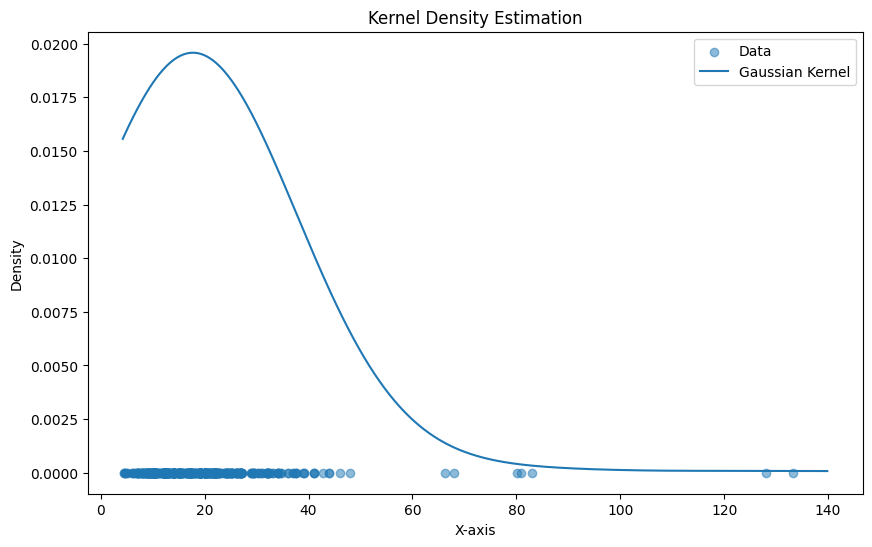

vertical threshold:  54.11048036656584
horizontal threshold:  41.57441352805452


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

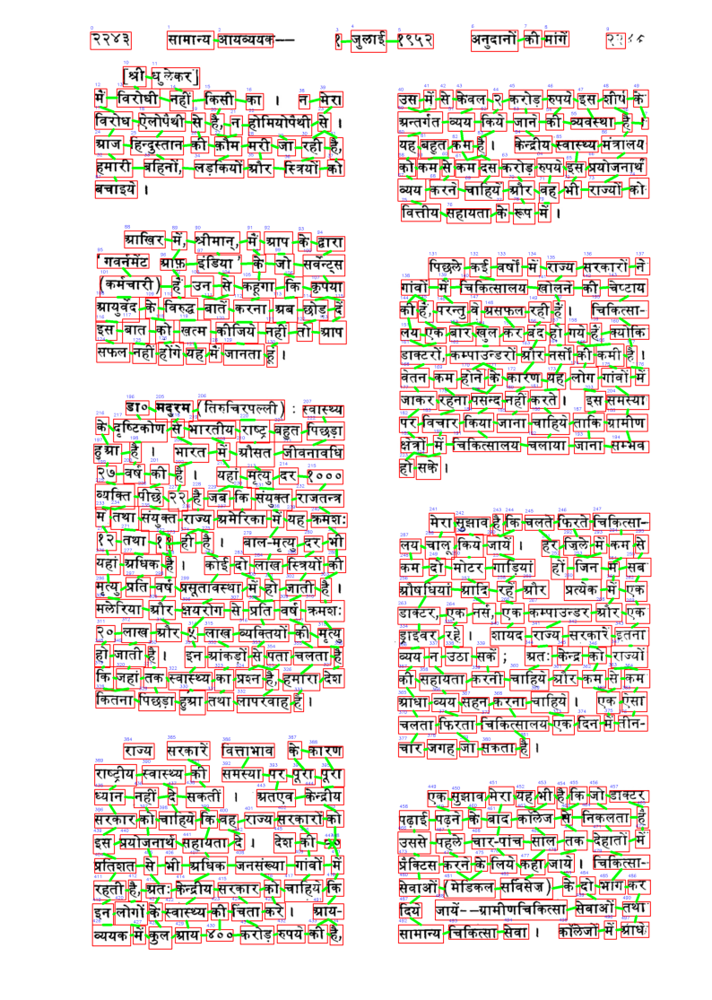

In [26]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(7, 8, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(7, 8, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img))
plt.axis("off")
plt.show()

The best thresholds for this image is:
- vertical threshold: 54
- horizontal threshold: 41

## IMAGE: 29

In [27]:
# loading the information of Top-Left and Bottom-Right of all boxes for a specific image
df = pd.read_csv('./Part-4/CSV/TLBR_29.csv')

In [28]:
# loading the image
img2 = cv2.imread('./Part-4/images/29.jpg')

(-0.5, 2474.5, 3499.5, -0.5)

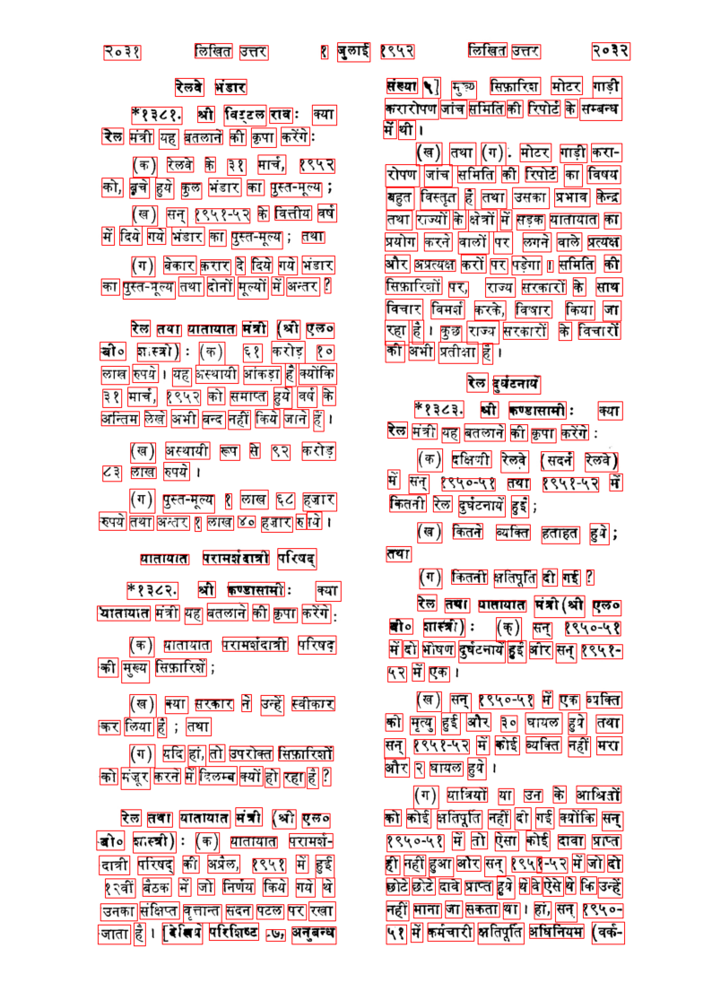

In [29]:
img_v = visualize_bboxes(img2)
plt.figure(figsize=(10, 20))
plt.imshow(img_v)
plt.axis("off")

In [30]:
# to calculate the 4 points of the bounding boxes (bottom-center, top-center, left-center, right-center)
df['Bottom'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Bottom-Right'].split(',')[1][:-1])], axis=1)
df['Top'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Top-Left'].split(',')[1][:-1])], axis=1)
df['Left'] = df.apply(lambda row: [int(row['Top-Left'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Right'] = df.apply(lambda row: [int(row['Bottom-Right'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Center'] = df.apply(lambda row: [(int(row['Top-Left'].split(',')[0][1:]) + int(row['Bottom-Right'].split(',')[0][1:]))/2.0, (int(row['Top-Left'].split(',')[1][:-1]) + int(row['Bottom-Right'].split(',')[1][:-1]))/2.0], axis=1)

In [31]:
df

,Unnamed: 0,Top-Left,Bottom-Right,Id,Bottom,Top,Left,Right,Center
0,0,"[338, 133]","[469, 185]",0,"[403.5, 185]","[403.5, 133]","[338, 159.0]","[469, 159.0]","[403.5, 159.0]"
1,1,"[662, 126]","[795, 178]",1,"[728.5, 178]","[728.5, 126]","[662, 152.0]","[795, 152.0]","[728.5, 152.0]"
2,2,"[822, 133]","[923, 185]",2,"[872.5, 185]","[872.5, 133]","[822, 159.0]","[923, 159.0]","[872.5, 159.0]"
3,3,"[592, 250]","[694, 314]",3,"[643.0, 314]","[643.0, 250]","[592, 282.0]","[694, 282.0]","[643.0, 282.0]"
4,4,"[735, 253]","[846, 308]",4,"[790.5, 308]","[790.5, 253]","[735, 280.5]","[846, 280.5]","[790.5, 280.5]"
...,...,...,...,...,...,...,...,...,...
427,427,"[1431, 3257]","[1474, 3326]",427,"[1452.5, 3326]","[1452.5, 3257]","[1431, 3291.5]","[1474, 3291.5]","[1452.5, 3291.5]"
428,428,"[1491, 3257]","[1656, 3322]",428,"[1573.5, 3322]","[1573.5, 3257]","[1491, 3289.5]","[1656, 3289.5]","[1573.5, 3289.5]"
429,429,"[1670, 3257]","[1834, 3333]",429,"[1752.0, 3333]","[1752.0, 3257]","[1670, 3295.0]","[1834, 3295.0]","[1752.0, 3295.0]"
430,430,"[1854, 3261]","[2047, 3312]",430,"[1950.5, 3312]","[1950.5, 3261]","[1854, 3286.5]","[2047, 3286.5]","[1950.5, 3286.5]"


In [32]:
distance_vertical = []
distance_horizontal = []

distance_horizontal, distance_vertical = find_distance(df)

distance_horizontal = np.array(distance_horizontal)
distance_vertical = np.array(distance_vertical)

print(distance_vertical.shape, distance_horizontal.shape)
print(distance_horizontal[0], distance_vertical[0])

(432,) (432,)
173.9482681718907 207.40781084616847


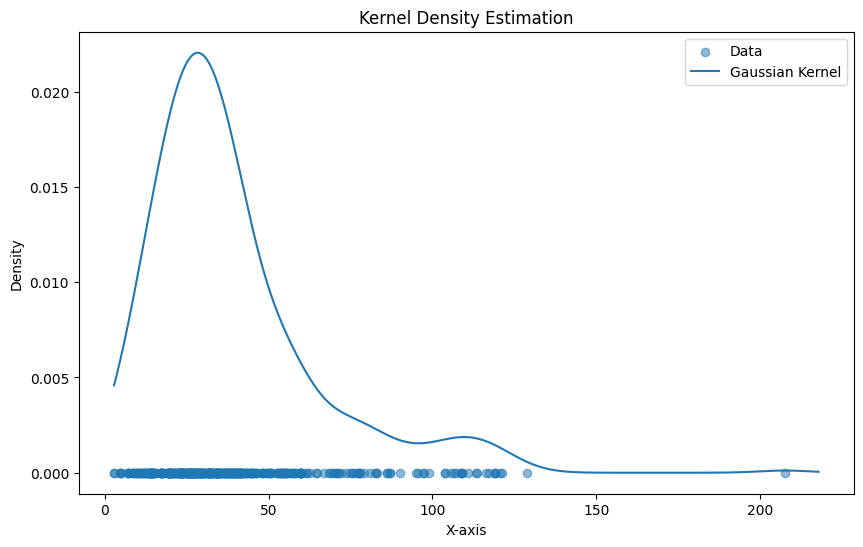

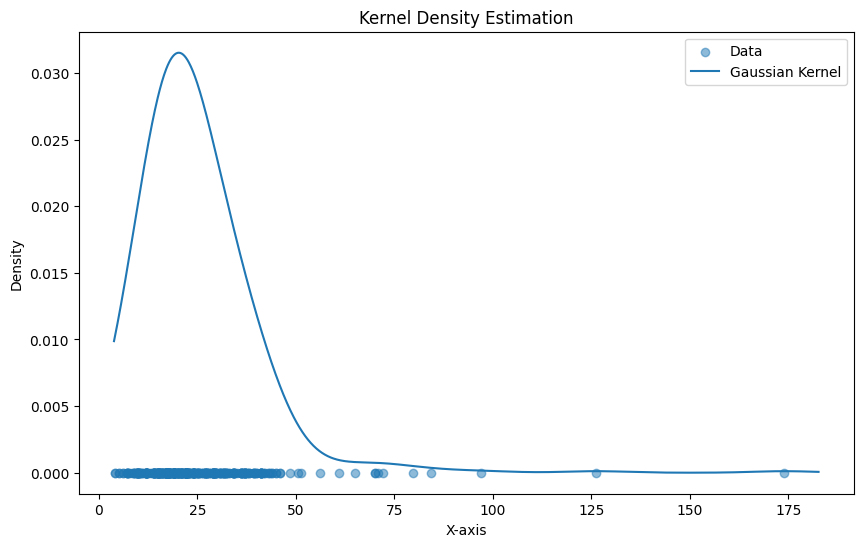

vertical threshold:  47.599815704507705
horizontal threshold:  36.2276863004697


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

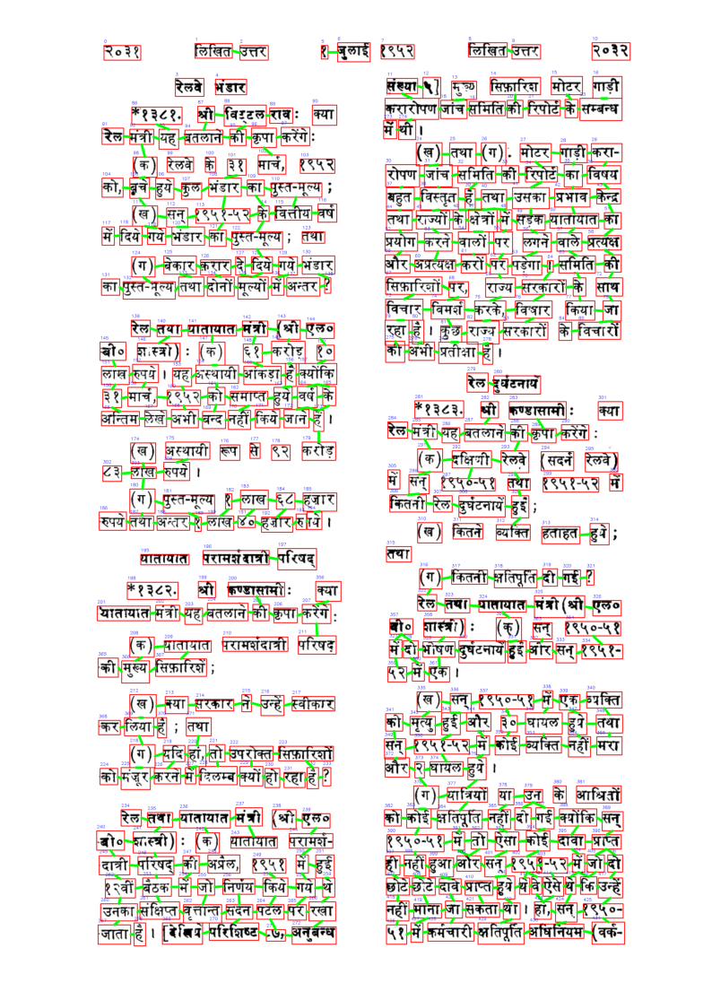

In [33]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(4, 5, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(4, 5, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img2))
plt.axis("off")
plt.show()

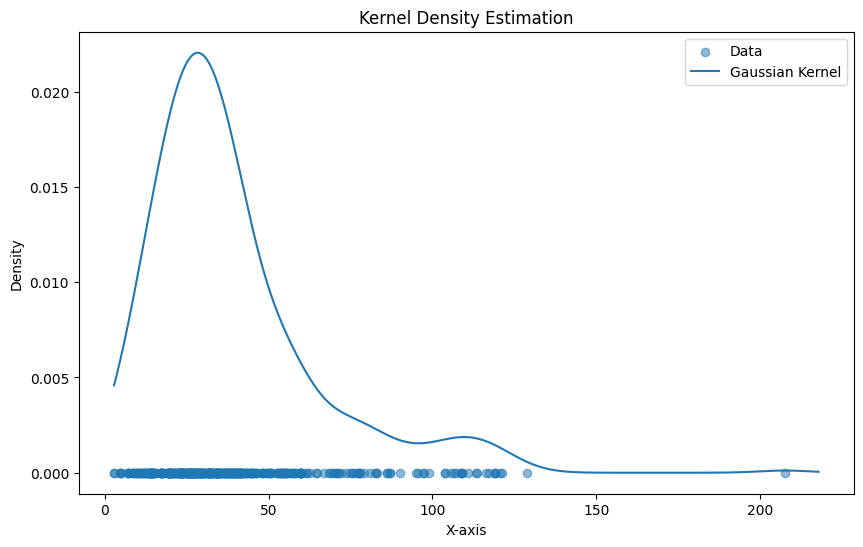

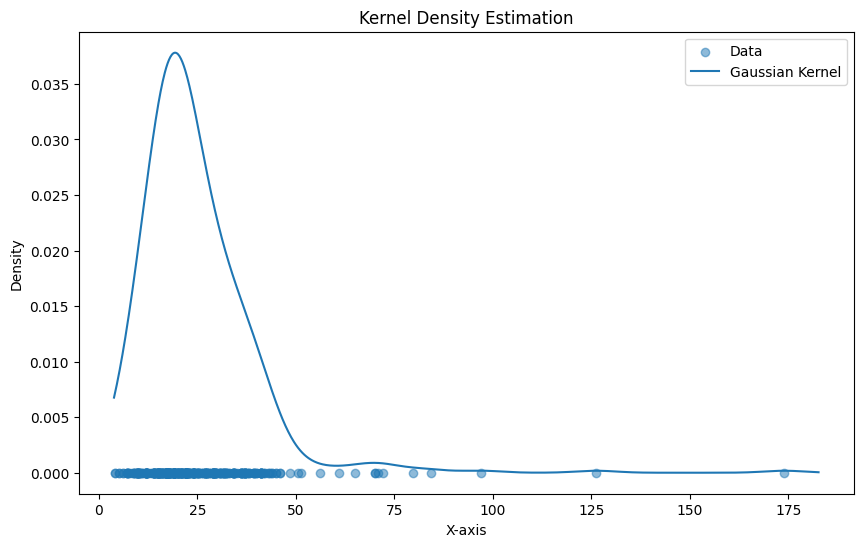

vertical threshold:  47.599815704507705
horizontal threshold:  32.82677931963805


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

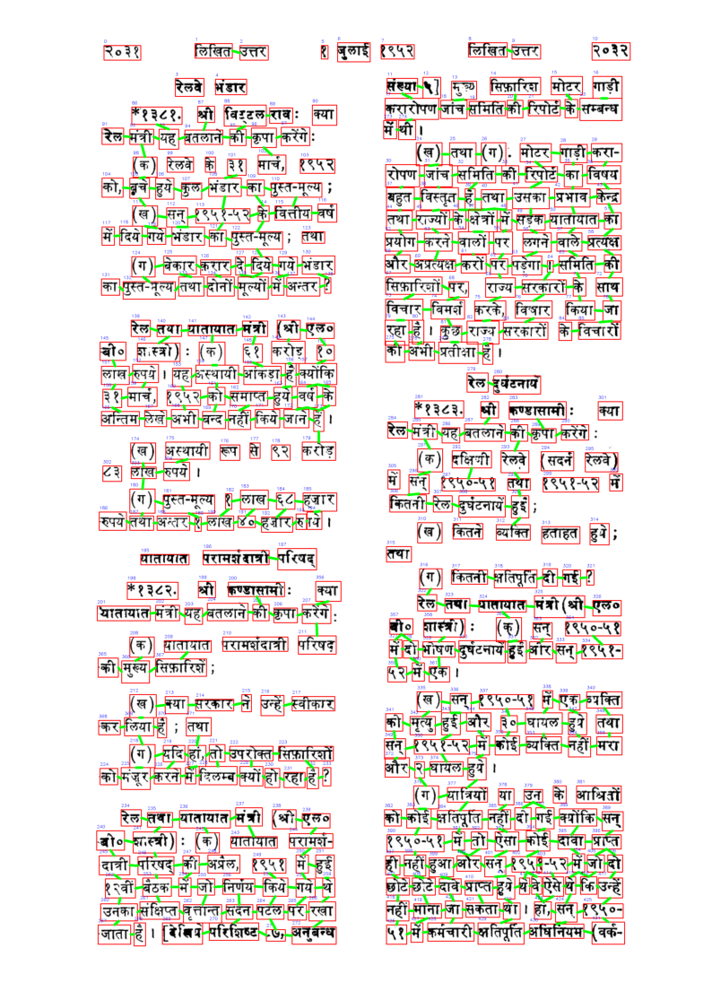

In [35]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(4, 5, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(3, 4, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img2))
plt.axis("off")
plt.show()

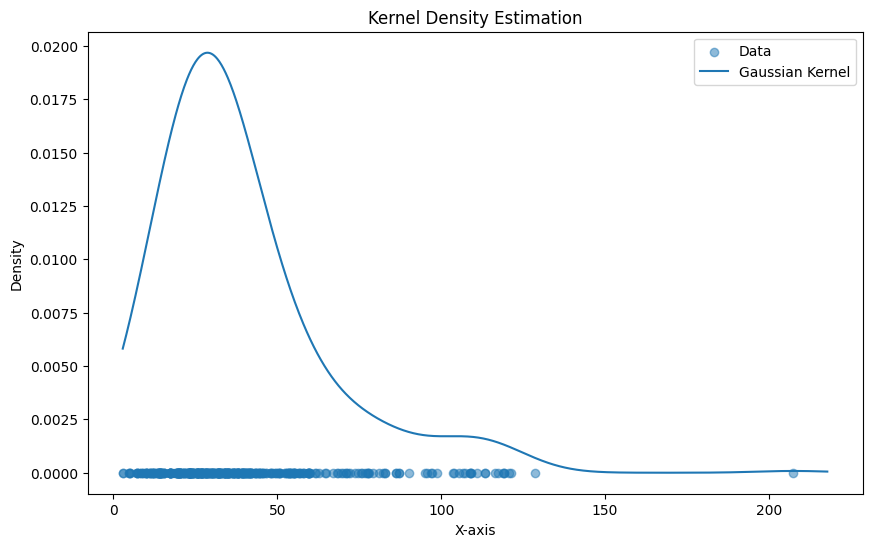

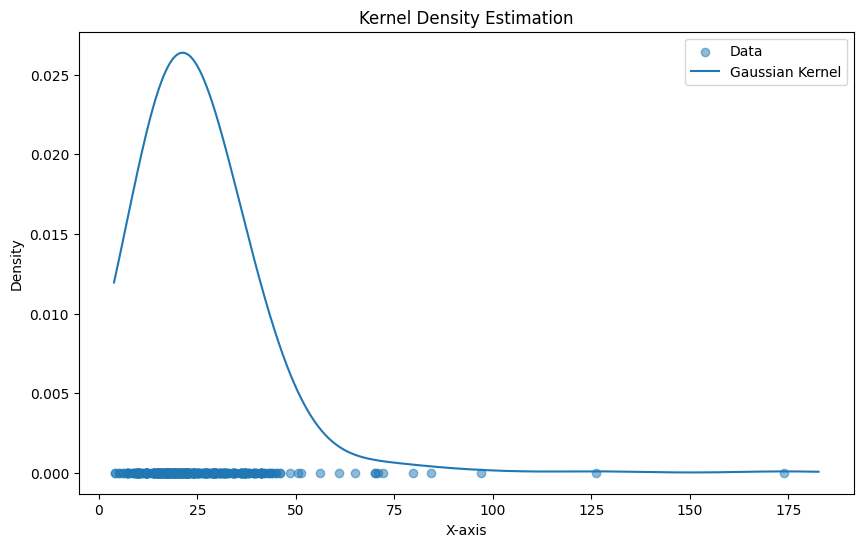

vertical threshold:  51.257252564972276
horizontal threshold:  39.62859328130136


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

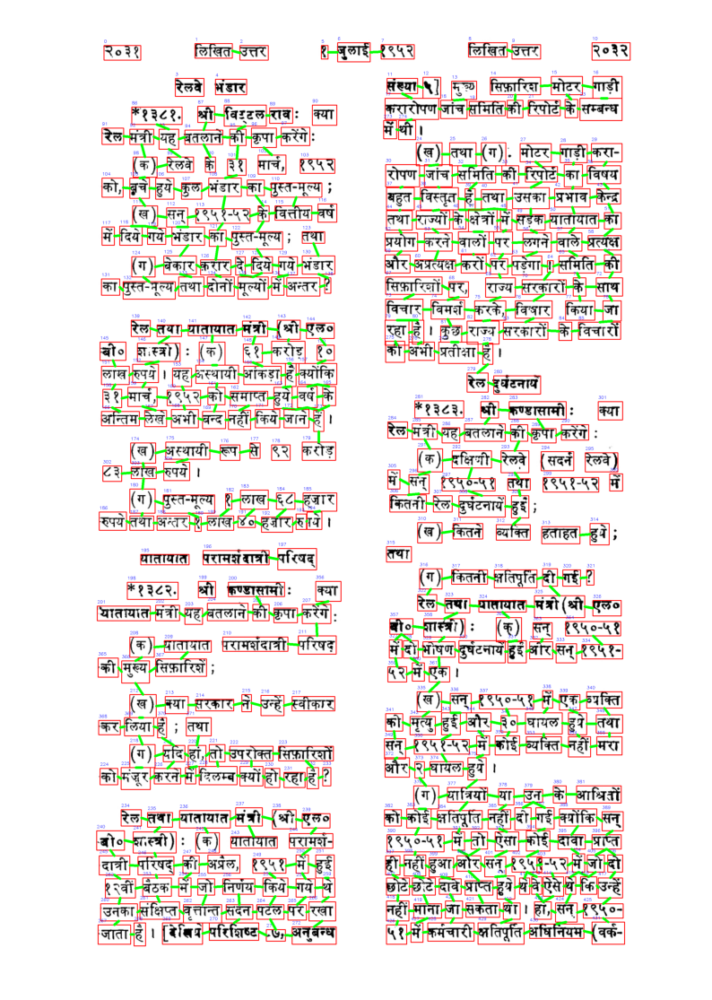

In [36]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(5, 6, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(5, 6, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img2))
plt.axis("off")
plt.show()

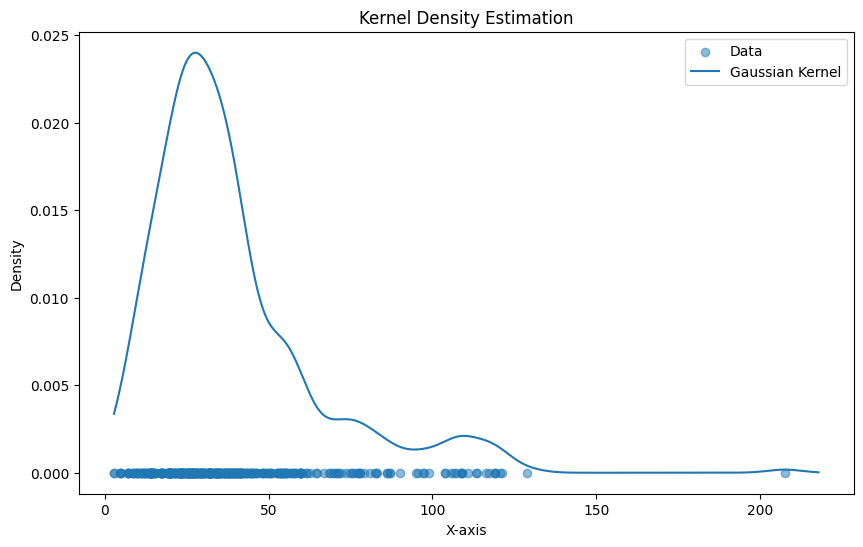

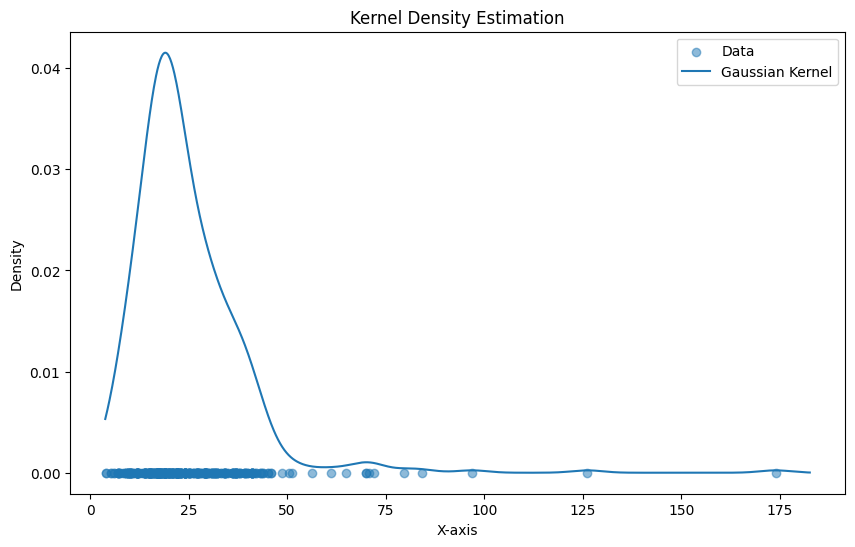

vertical threshold:  44.802952222975975
horizontal threshold:  30.85783317284077


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

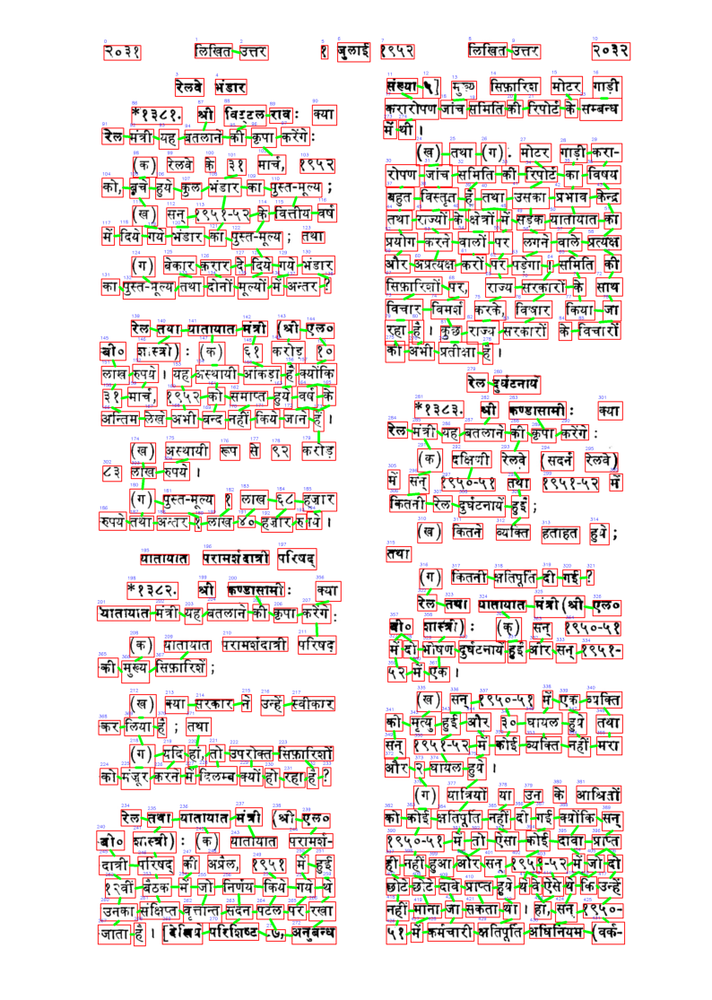

In [37]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(3, 4, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(2, 3, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img2))
plt.axis("off")
plt.show()

the best threshold for this image is:
- vertical threshold: 54
- horizontal threshold: 39

## IMAGE: 159

In [61]:
# loading the information of Top-Left and Bottom-Right of all boxes for a specific image
df = pd.read_csv('./Part-4/CSV/TLBR_159.csv')

# loading the image
img3 = cv2.imread('./Part-4/images/159.jpg')

(-0.5, 2474.5, 3499.5, -0.5)

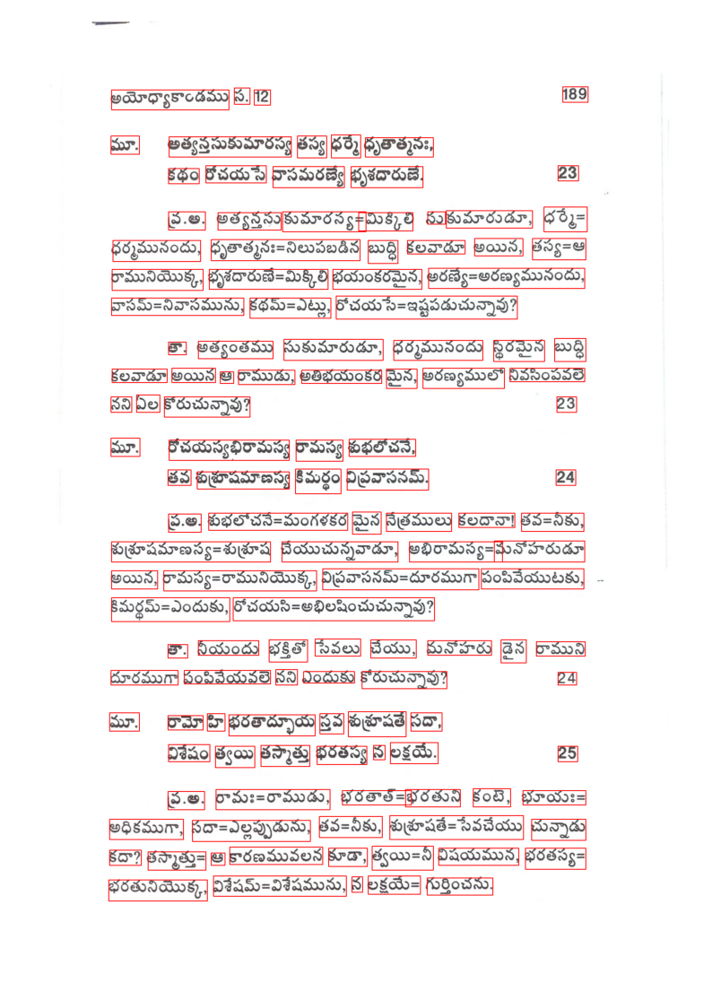

In [39]:
img_v = visualize_bboxes(img3)
plt.figure(figsize=(10, 20))
plt.imshow(img_v)
plt.axis("off")

In [40]:
# to calculate the 4 points of the bounding boxes (bottom-center, top-center, left-center, right-center)
df['Bottom'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Bottom-Right'].split(',')[1][:-1])], axis=1)
df['Top'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Top-Left'].split(',')[1][:-1])], axis=1)
df['Left'] = df.apply(lambda row: [int(row['Top-Left'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Right'] = df.apply(lambda row: [int(row['Bottom-Right'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Center'] = df.apply(lambda row: [(int(row['Top-Left'].split(',')[0][1:]) + int(row['Bottom-Right'].split(',')[0][1:]))/2.0, (int(row['Top-Left'].split(',')[1][:-1]) + int(row['Bottom-Right'].split(',')[1][:-1]))/2.0], axis=1)

In [41]:
distance_vertical = []
distance_horizontal = []

distance_horizontal, distance_vertical = find_distance(df)

distance_horizontal = np.array(distance_horizontal)
distance_vertical = np.array(distance_vertical)

print(distance_vertical.shape, distance_horizontal.shape)
print(distance_horizontal[0], distance_vertical[0])

(129,) (129,)
23.30772404161333 185.497304562627


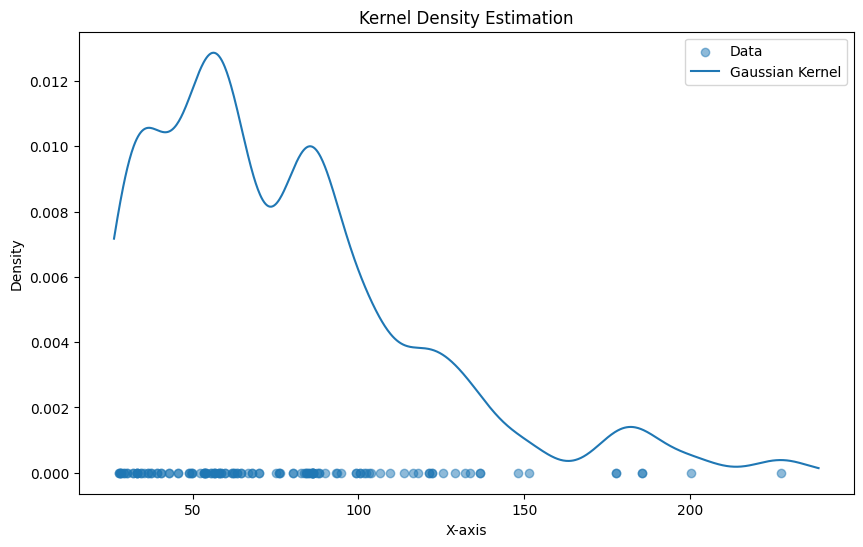

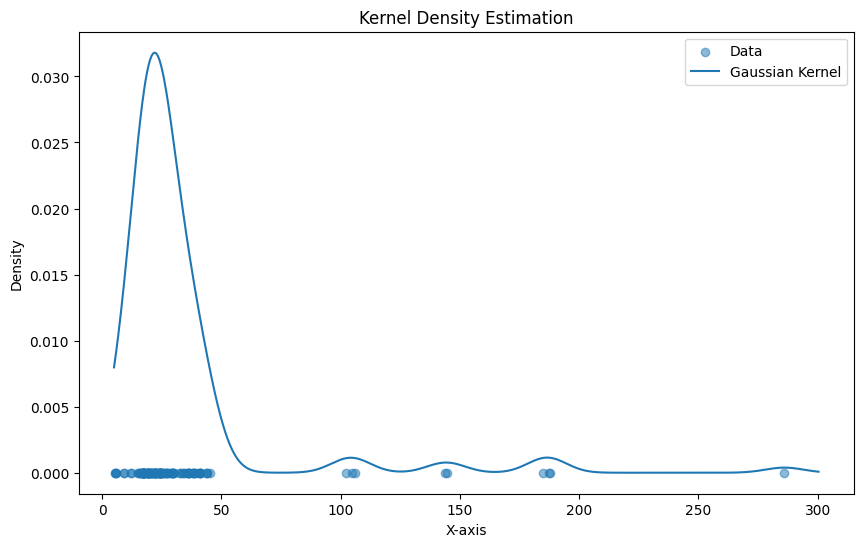

vertical threshold:  99.03373940336603
horizontal threshold:  36.89190497667258


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Bottom_

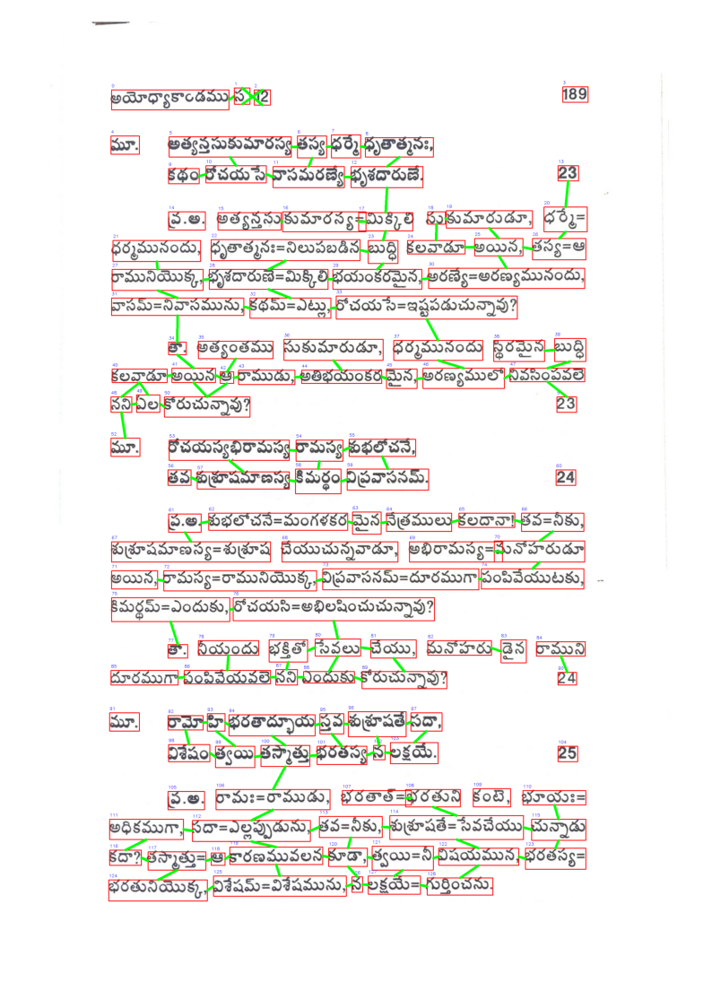

In [42]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(4, 5, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(4, 5, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img3))
plt.axis("off")
plt.show()

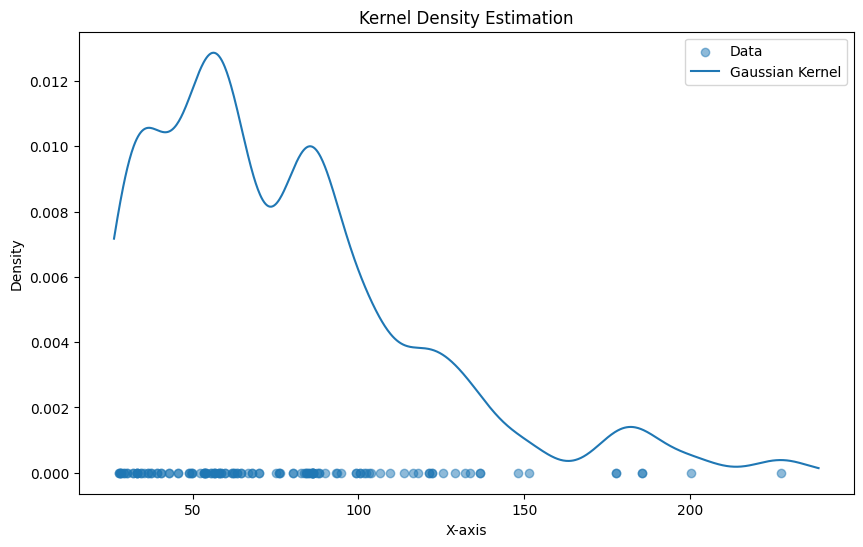

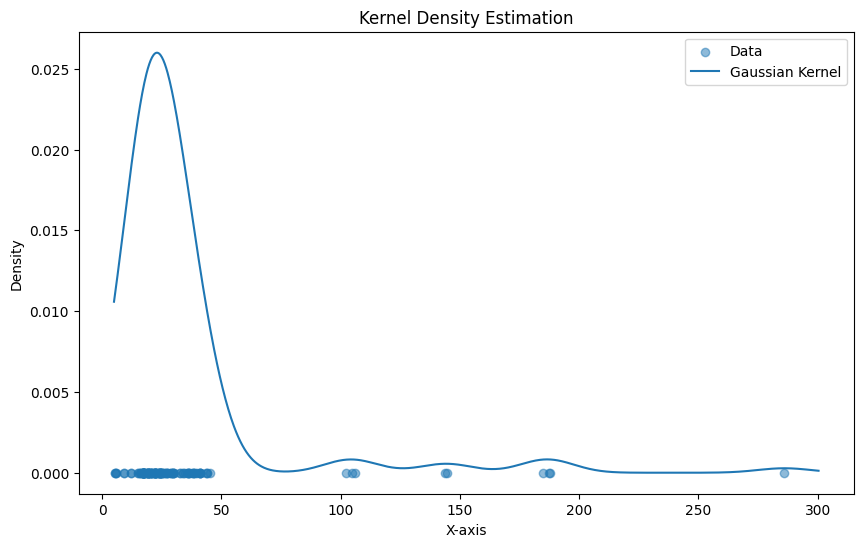

vertical threshold:  65.207634156837
horizontal threshold:  40.43998935277703


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

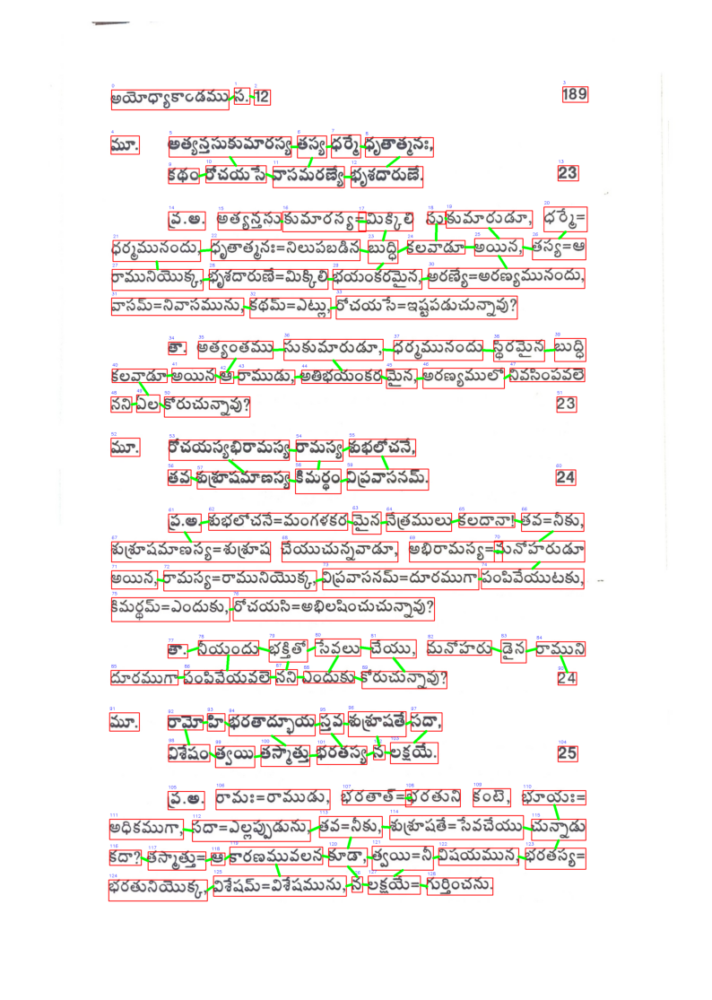

In [46]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(4, 5, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(5, 6, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img3))
plt.axis("off")
plt.show()

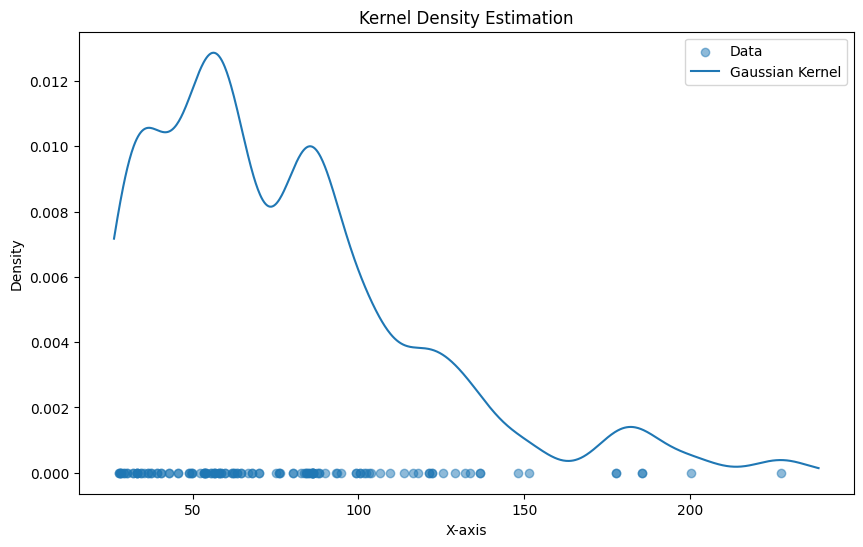

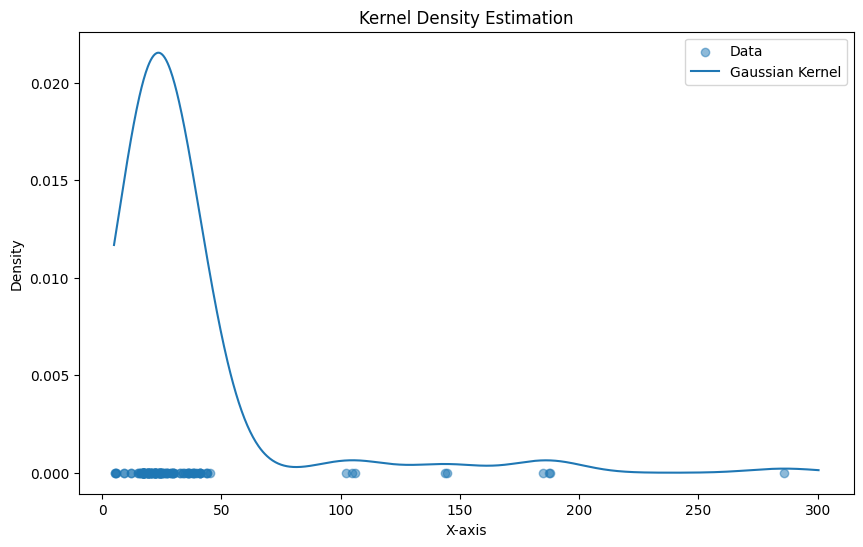

vertical threshold:  65.207634156837
horizontal threshold:  44.28374742689019


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

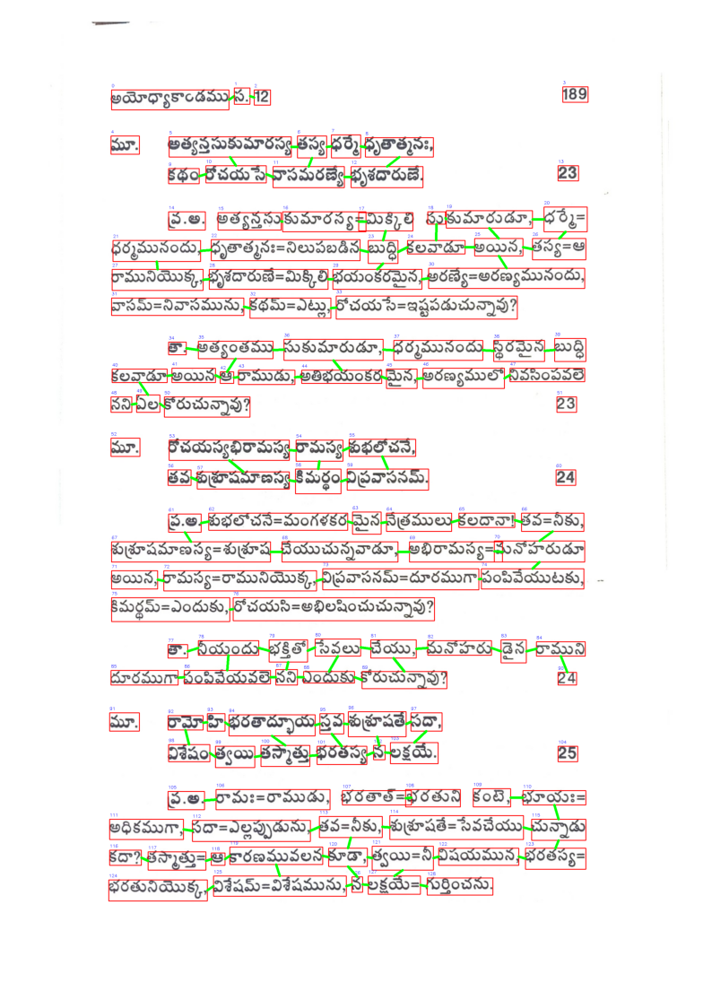

In [45]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(3, 4, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(6, 7, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img3))
plt.axis("off")
plt.show()

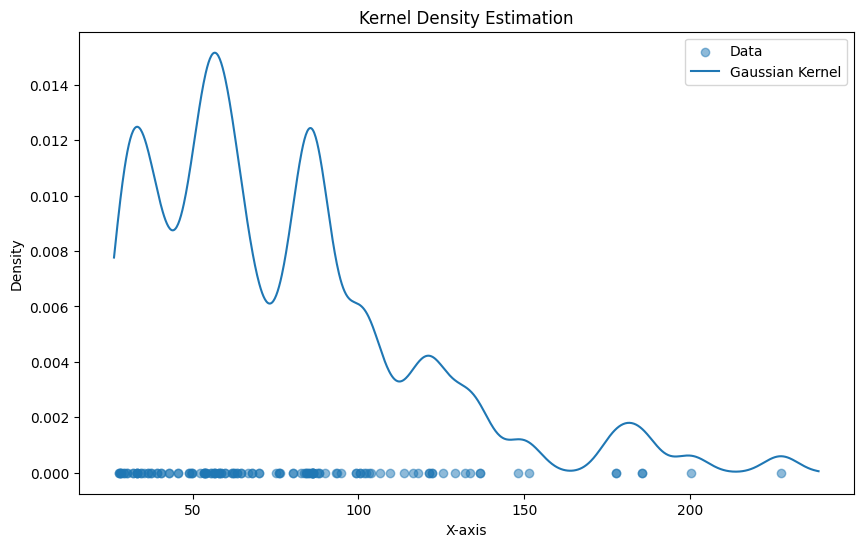

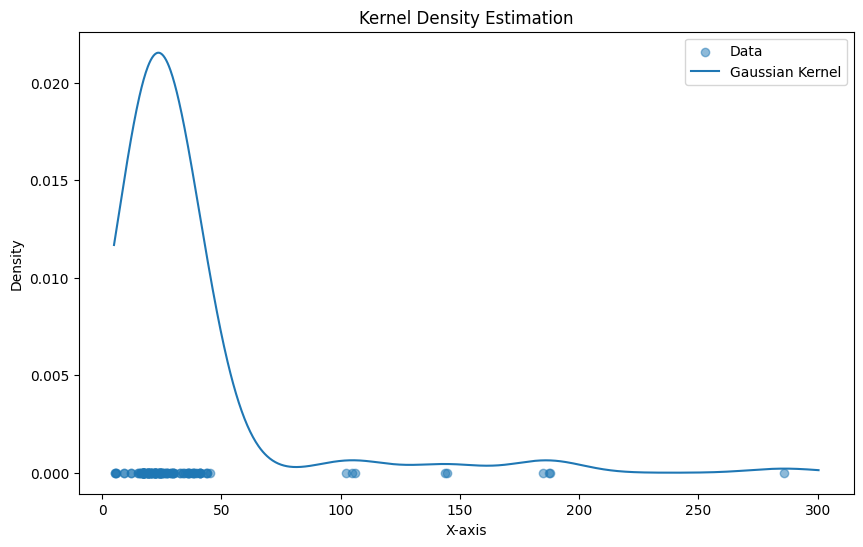

vertical threshold:  86.90739978668582
horizontal threshold:  44.28374742689019


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

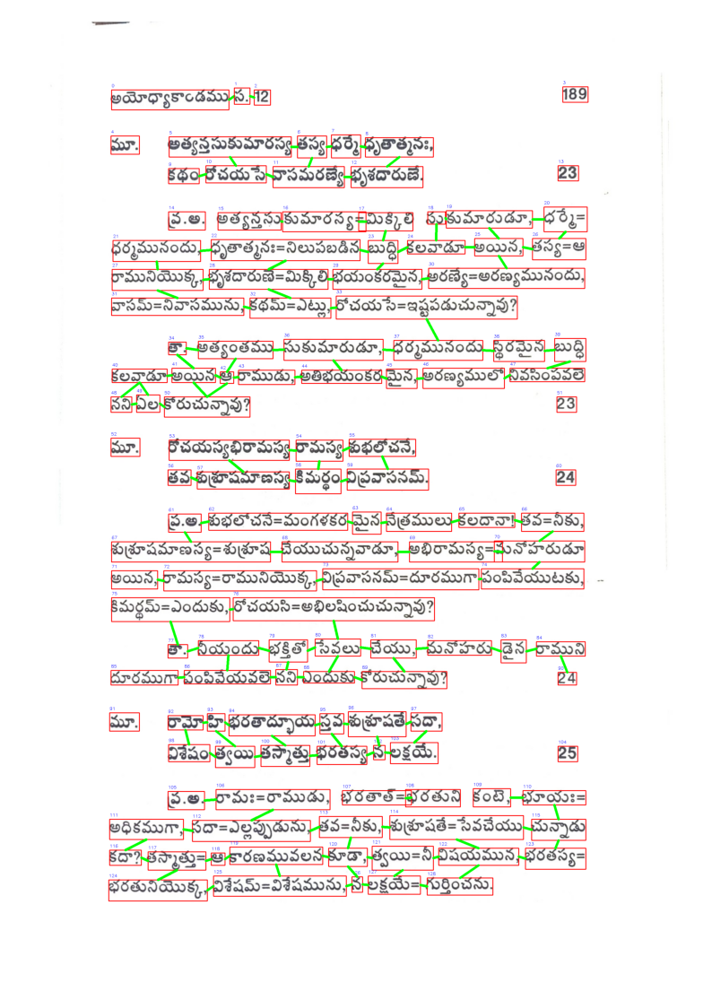

In [48]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(2, 3, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(6, 8, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img3))
plt.axis("off")
plt.show()

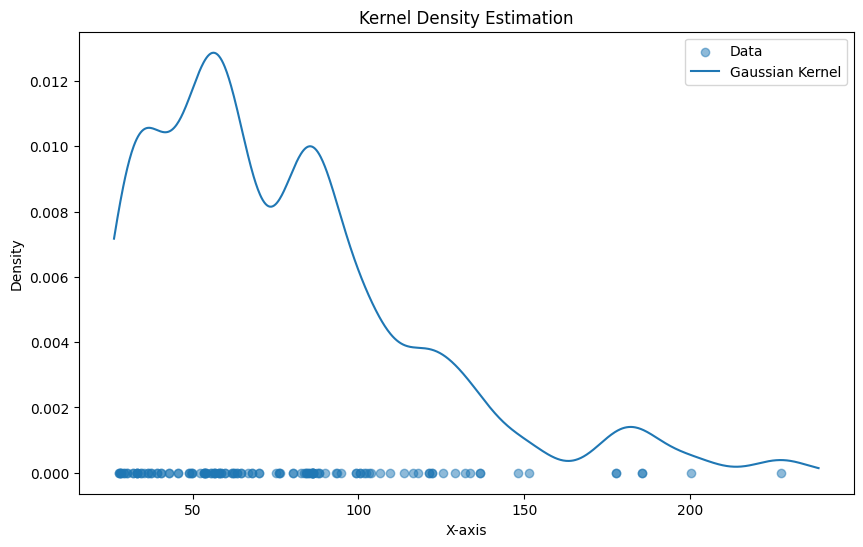

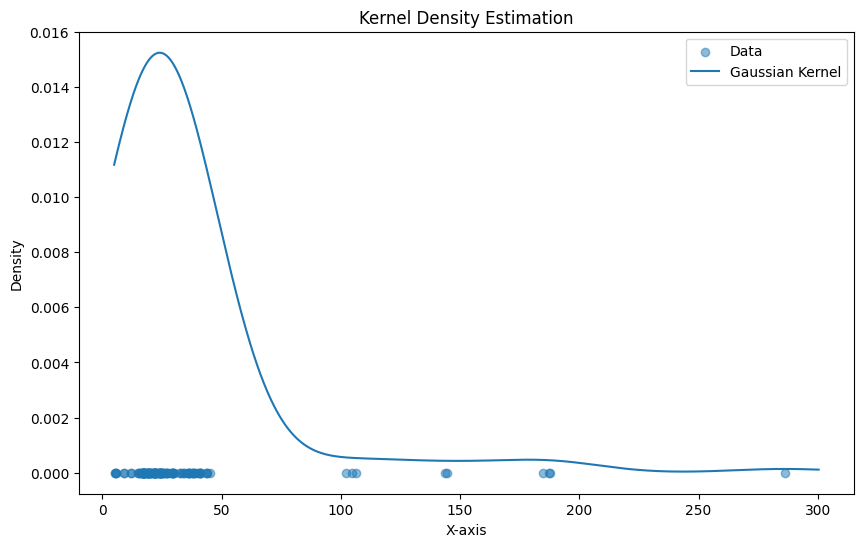

vertical threshold:  65.207634156837
horizontal threshold:  52.85828466914262


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

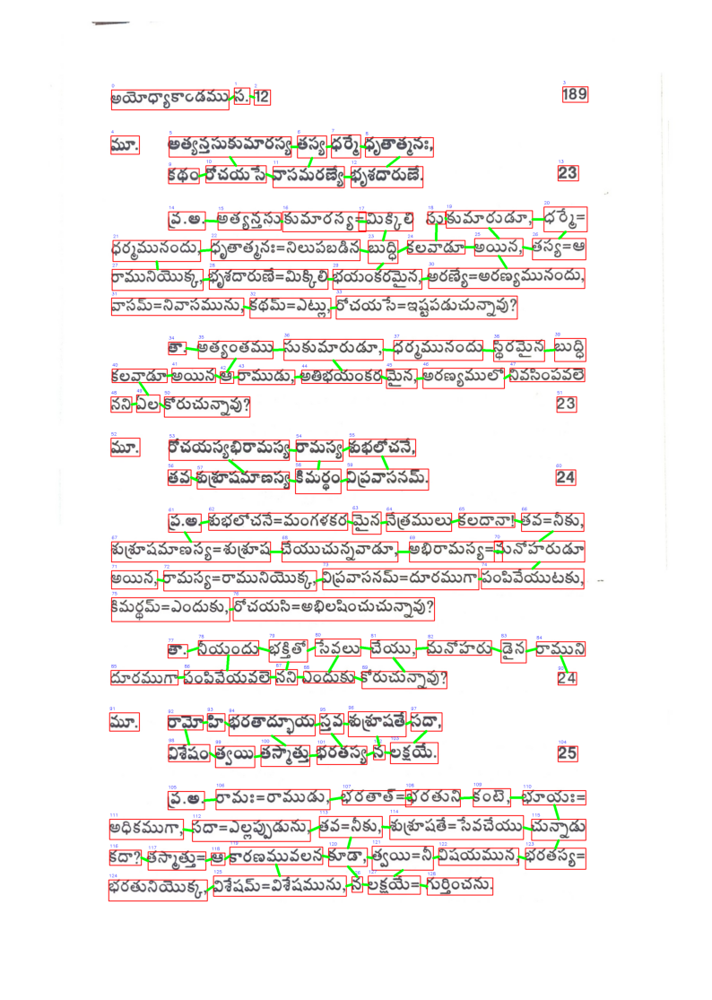

In [49]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(3, 4, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(8, 9, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img3))
plt.axis("off")
plt.show()

the best threshold for this image is:
- vertical threshold: 64
- horizontal threshold: 44

## IMAGE: 201

In [50]:
# loading the information of Top-Left and Bottom-Right of all boxes for a specific image
df = pd.read_csv('./Part-4/CSV/TLBR_201.csv')

# loading the image
img3 = cv2.imread('./Part-4/images/201.jpg')

(-0.5, 2474.5, 3499.5, -0.5)

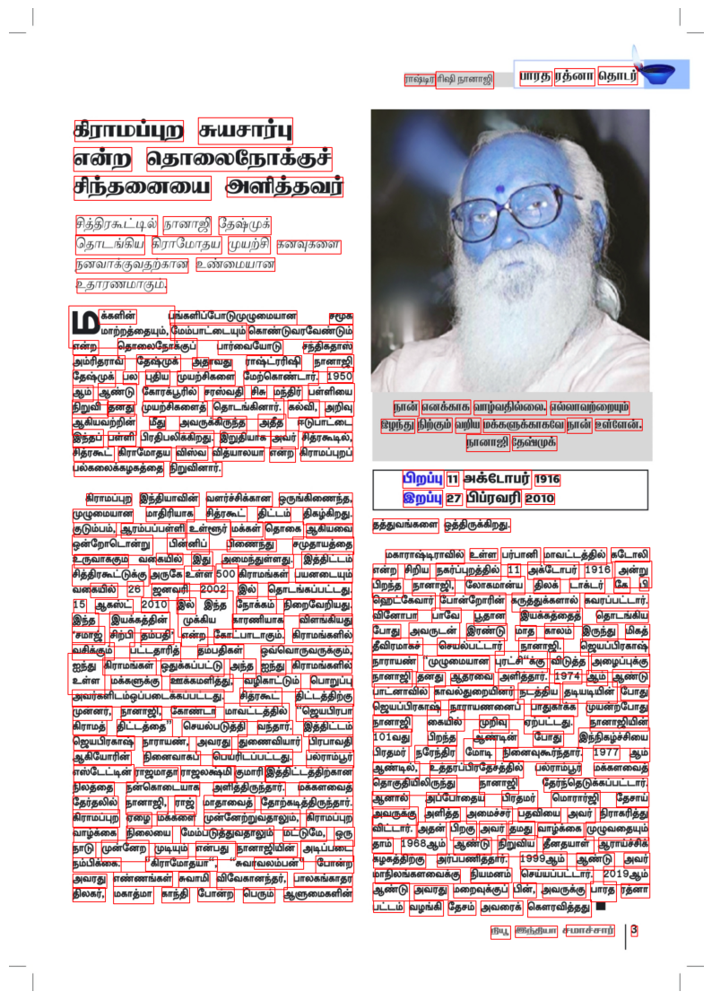

In [51]:
img_v = visualize_bboxes(img3)
plt.figure(figsize=(10, 20))
plt.imshow(img_v, cmap='gray')
plt.axis("off")

In [52]:
# to calculate the 4 points of the bounding boxes (bottom-center, top-center, left-center, right-center)
df['Bottom'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Bottom-Right'].split(',')[1][:-1])], axis=1)
df['Top'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Top-Left'].split(',')[1][:-1])], axis=1)
df['Left'] = df.apply(lambda row: [int(row['Top-Left'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Right'] = df.apply(lambda row: [int(row['Bottom-Right'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Center'] = df.apply(lambda row: [(int(row['Top-Left'].split(',')[0][1:]) + int(row['Bottom-Right'].split(',')[0][1:]))/2.0, (int(row['Top-Left'].split(',')[1][:-1]) + int(row['Bottom-Right'].split(',')[1][:-1]))/2.0], axis=1)

In [53]:
distance_vertical = []
distance_horizontal = []

distance_horizontal, distance_vertical = find_distance(df)

distance_horizontal = np.array(distance_horizontal)
distance_vertical = np.array(distance_vertical)

print(distance_vertical.shape, distance_horizontal.shape)
print(distance_horizontal[0], distance_vertical[0])

(363,) (363,)
2.0 167.45521789421792


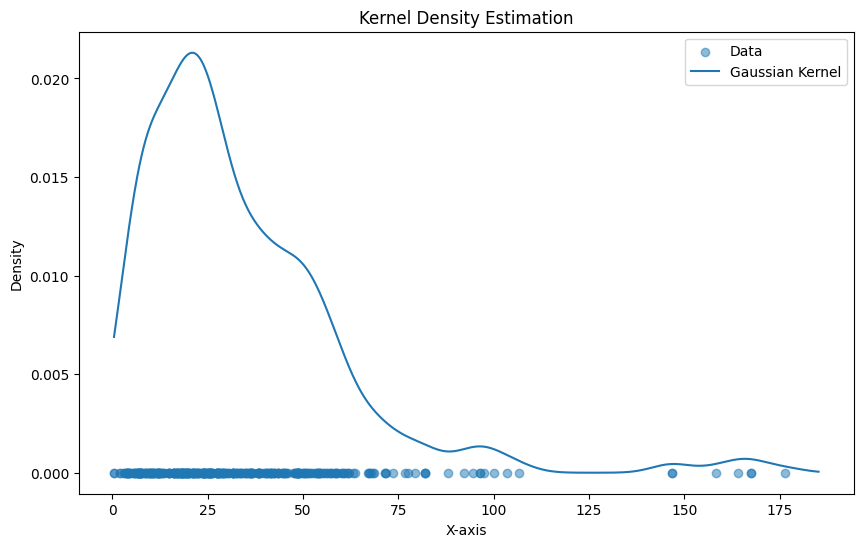

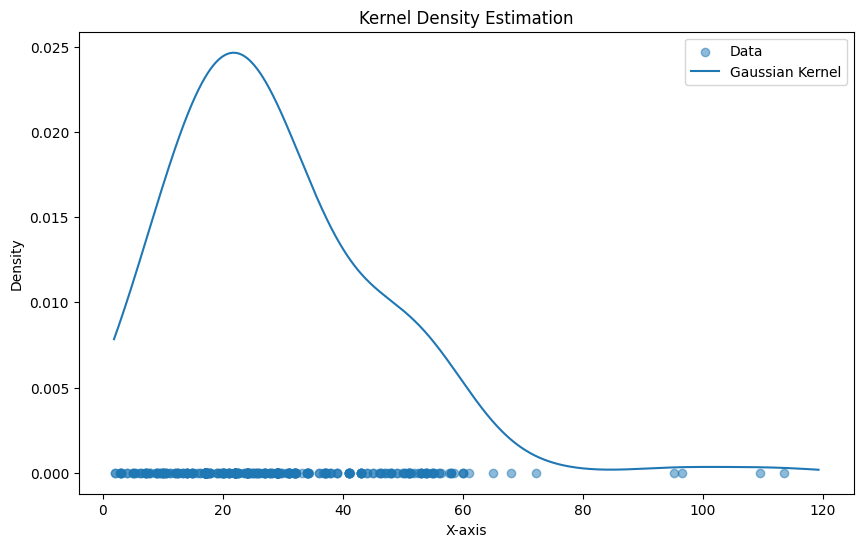

vertical threshold:  49.66243060745202
horizontal threshold:  41.50918904390669


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

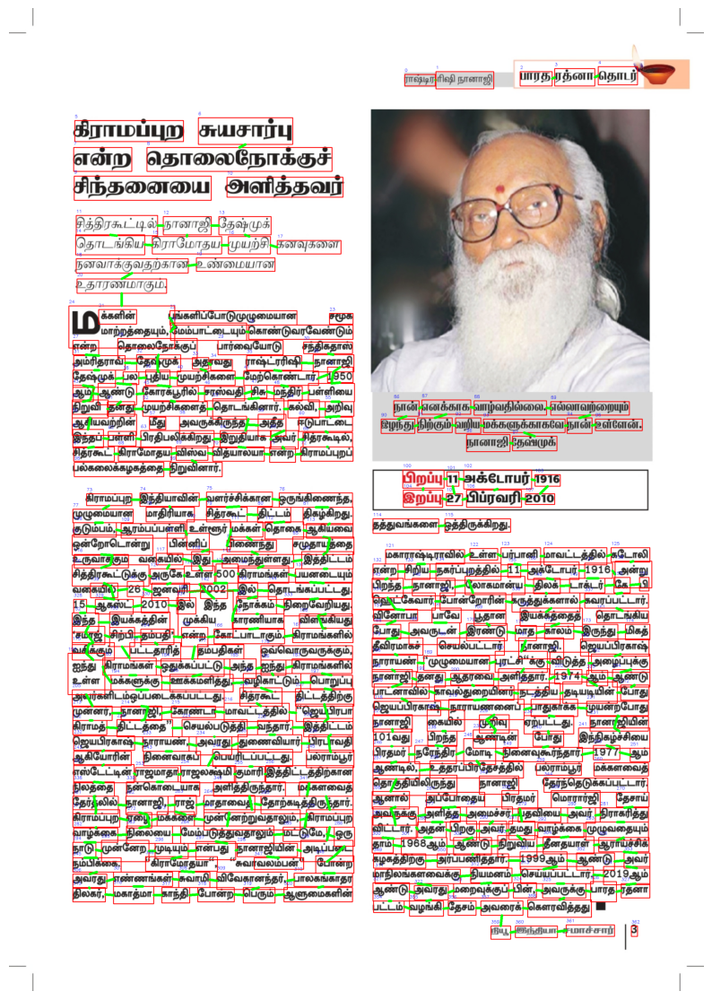

In [55]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(3, 4, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(4, 5, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img3))
plt.axis("off")
plt.show()

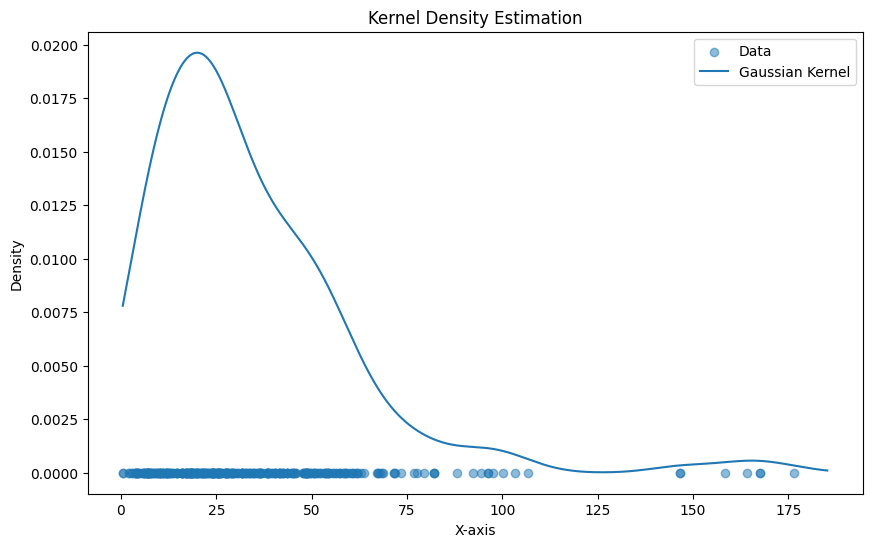

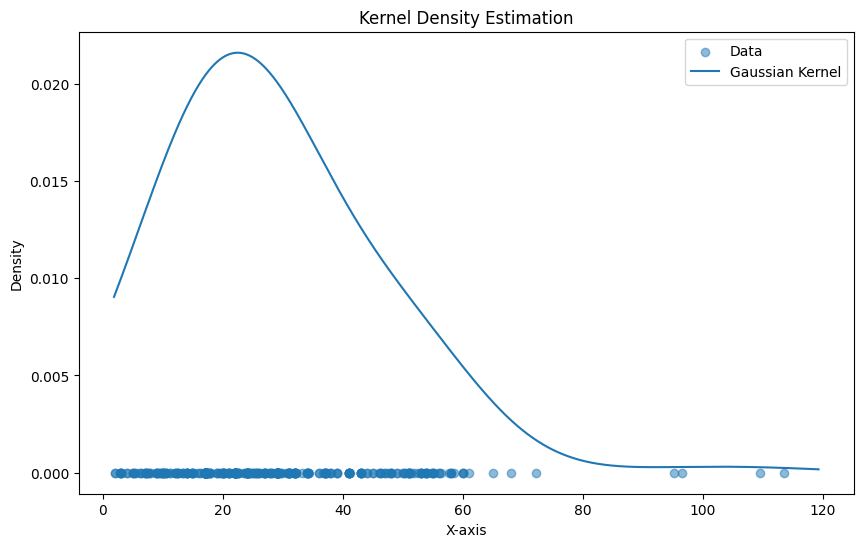

vertical threshold:  50.77192152340959
horizontal threshold:  46.798249895466924


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

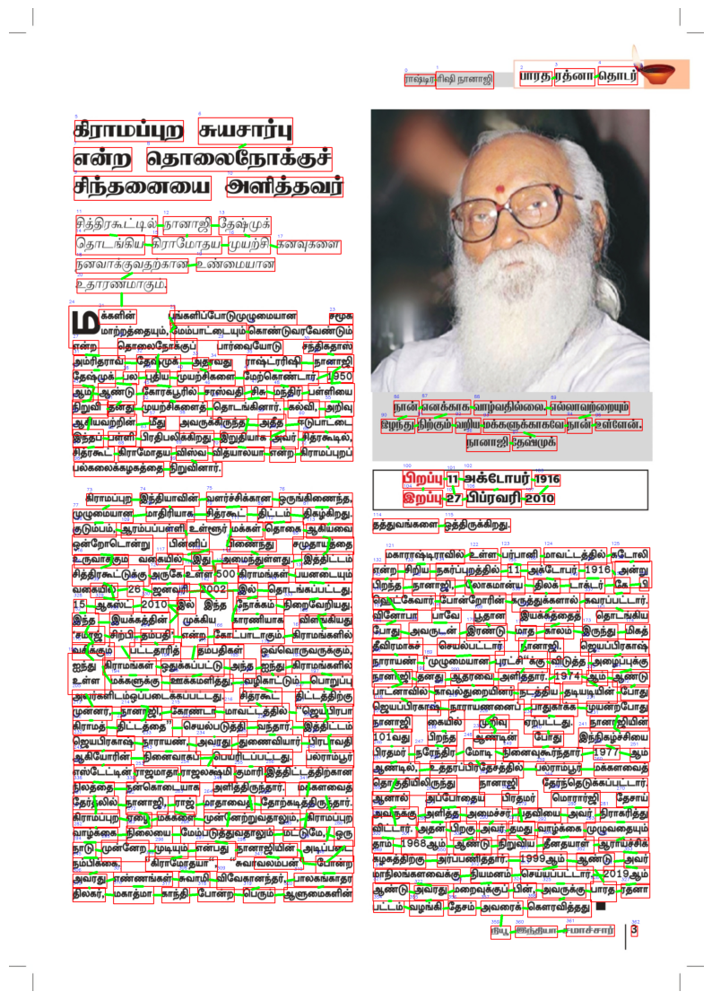

In [56]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(4, 5, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(5, 6, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img3))
plt.axis("off")
plt.show()

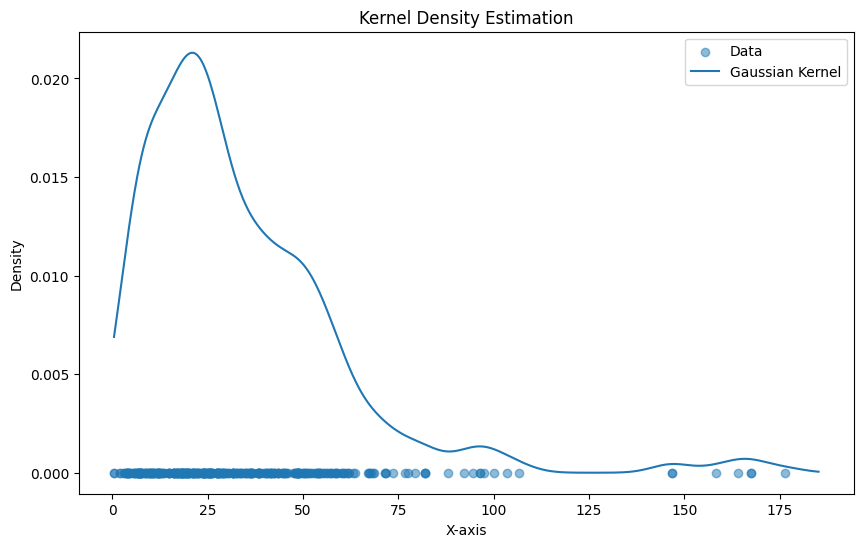

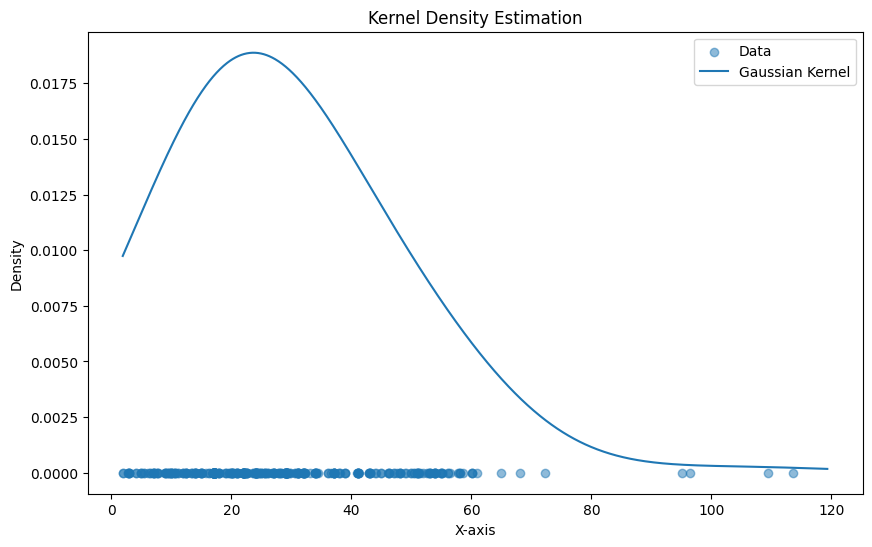

vertical threshold:  49.66243060745202
horizontal threshold:  50.79442920553466


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

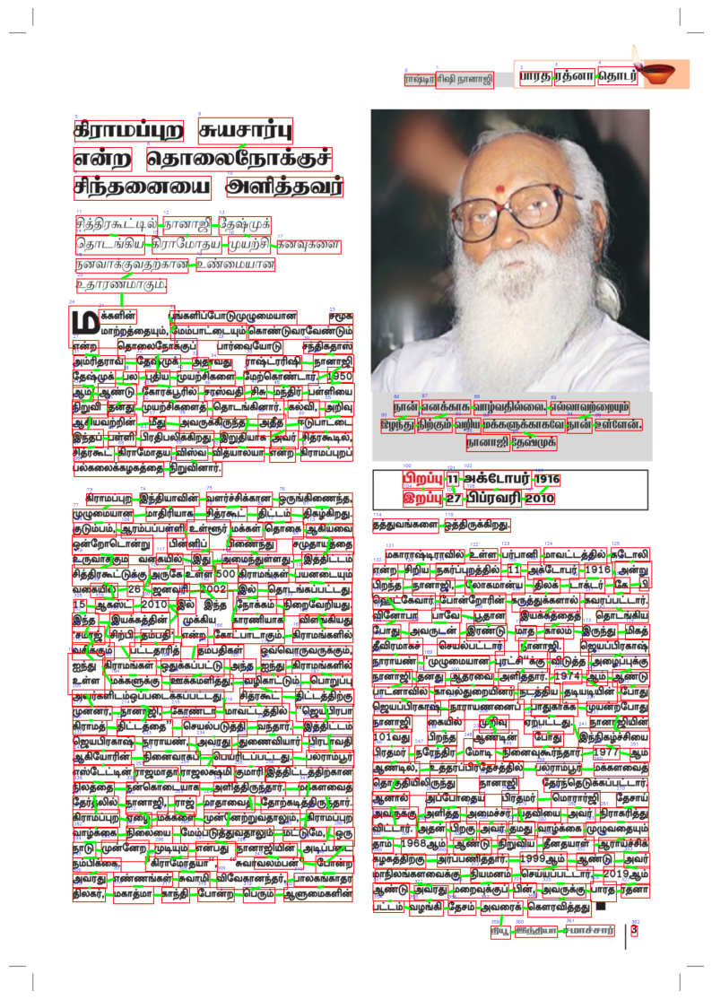

In [58]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(3, 6, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(6, 7, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img3))
plt.axis("off")
plt.show()

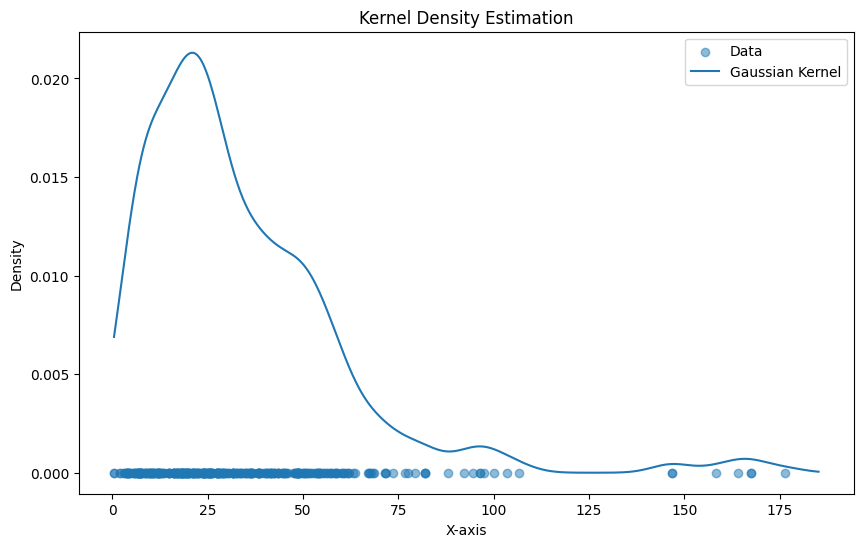

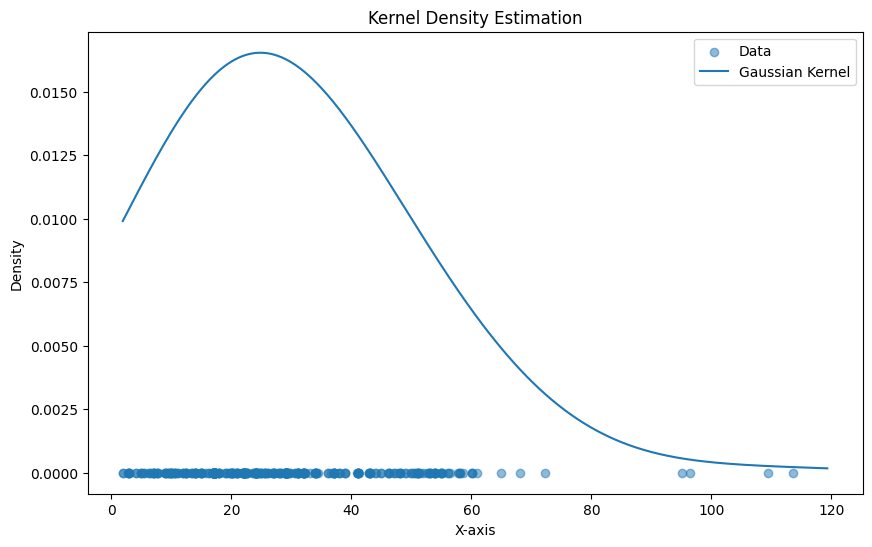

vertical threshold:  49.66243060745202
horizontal threshold:  54.67307383001217


C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

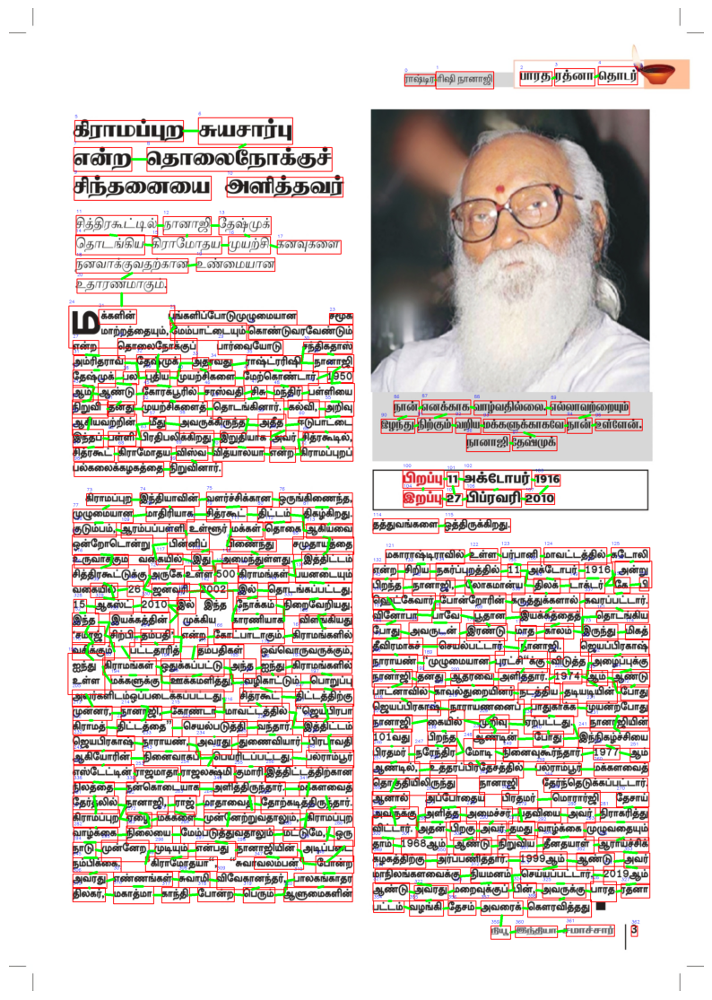

In [59]:

kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(3, 4, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_v.visualize()
plt.show()

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(7, 8, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
plt.figure(figsize=(10, 6))
kde_h.visualize()
plt.show()

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]
print("vertical threshold: ", vertical_threshold)

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]
print("horizontal threshold: ", horizontal_threshold)

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.figure(figsize=(10, 20))
plt.imshow(make_connections(img3))
plt.axis("off")
plt.show()

the best threshold for this image is:
- vertical threshold: 49
- horizontal threshold: 54

# COMPARISON BETWEEN THE TWO IMPLEMENTATION

In this task, I take the thresholds for the images from Assignment 2, and use the thresholds from the above implementation (or find the threshold for the images i didn't run the above implementation on). Then I compare the results of the two implementation.

### IMAGE 29

C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

(-0.5, 2474.5, 3499.5, -0.5)

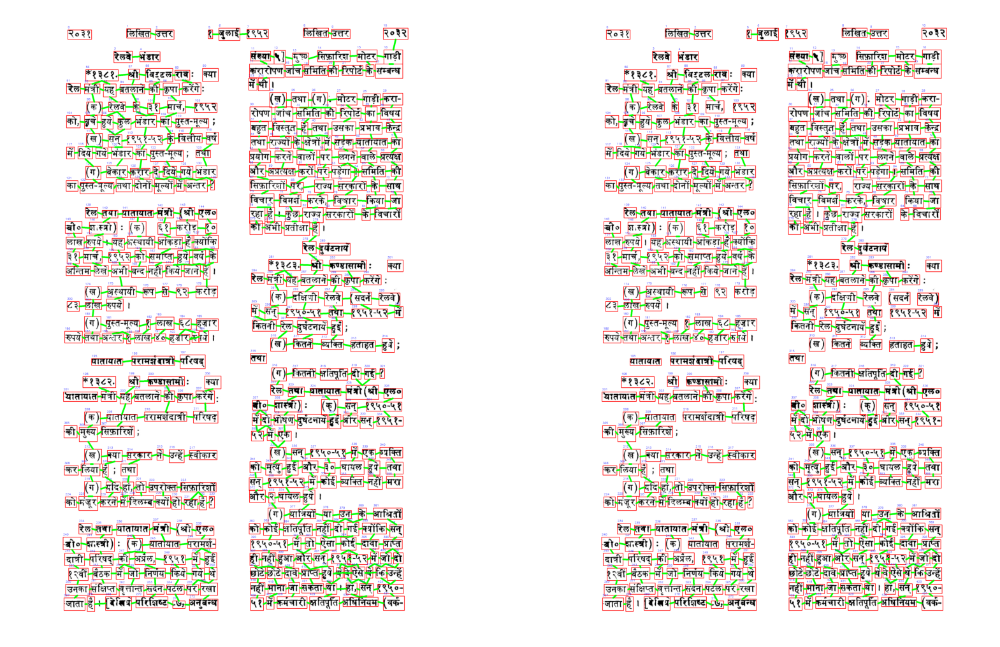

In [66]:
df = pd.read_csv('./Part-4/CSV/TLBR_29.csv')
# loading the image
img = cv2.imread('./Part-4/images/29.jpg')
# to calculate the 5 points of the bounding boxes (bottom-center, top-center, left-center, right-center, center)
df['Bottom'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Bottom-Right'].split(',')[1][:-1])], axis=1)
df['Top'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Top-Left'].split(',')[1][:-1])], axis=1)
df['Left'] = df.apply(lambda row: [int(row['Top-Left'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Right'] = df.apply(lambda row: [int(row['Bottom-Right'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Center'] = df.apply(lambda row: [(int(row['Top-Left'].split(',')[0][1:]) + int(row['Bottom-Right'].split(',')[0][1:]))/2.0, (int(row['Top-Left'].split(',')[1][:-1]) + int(row['Bottom-Right'].split(',')[1][:-1]))/2.0], axis=1)

plt.figure(figsize=(20, 20))

# for Assignment 2
threshold = 62.6

df = find_connections(df, vertical_threshold=threshold, horizontal_threshold = threshold)
plt.subplot(1, 2, 1)
plt.imshow(make_connections(img))
plt.axis("off")

# for this assignment 
vertical_threshold = 51
horizontal_threshold = 39
df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.subplot(1, 2, 2)
plt.imshow(make_connections(img))
plt.axis("off")
# plt.show()

### IMAGE 68

C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

(-0.5, 2474.5, 3499.5, -0.5)

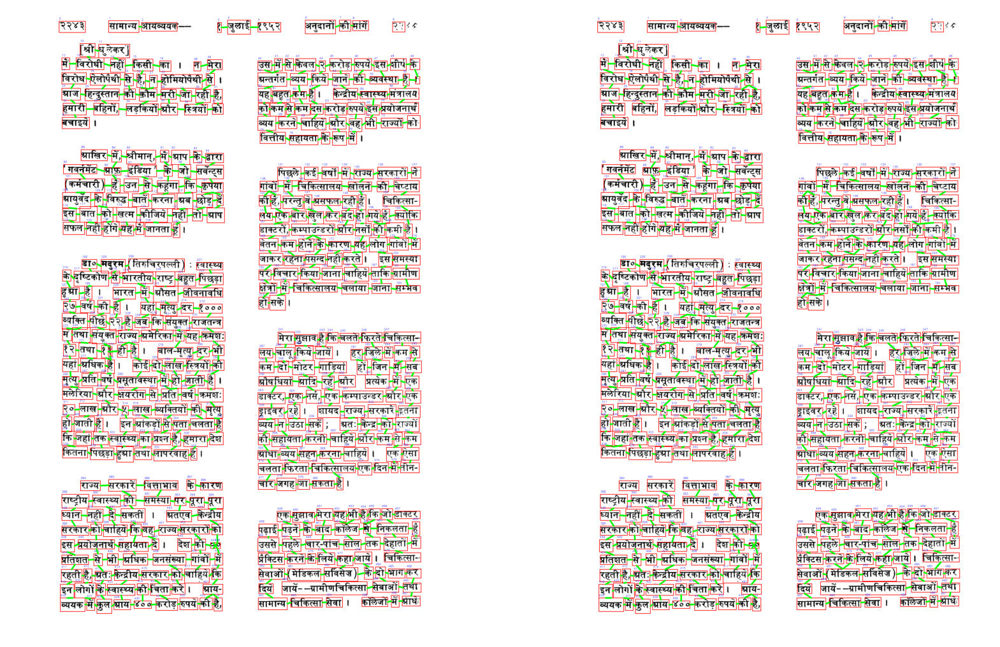

In [68]:
df = pd.read_csv('./Part-4/CSV/TLBR_68.csv')
# loading the image
img = cv2.imread('./Part-4/images/68.jpg')
# to calculate the 5 points of the bounding boxes (bottom-center, top-center, left-center, right-center, center)
df['Bottom'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Bottom-Right'].split(',')[1][:-1])], axis=1)
df['Top'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Top-Left'].split(',')[1][:-1])], axis=1)
df['Left'] = df.apply(lambda row: [int(row['Top-Left'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Right'] = df.apply(lambda row: [int(row['Bottom-Right'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Center'] = df.apply(lambda row: [(int(row['Top-Left'].split(',')[0][1:]) + int(row['Bottom-Right'].split(',')[0][1:]))/2.0, (int(row['Top-Left'].split(',')[1][:-1]) + int(row['Bottom-Right'].split(',')[1][:-1]))/2.0], axis=1)

plt.figure(figsize=(20, 20))

# for Assignment 2
threshold = 47

df = find_connections(df, vertical_threshold=threshold, horizontal_threshold = threshold)
plt.subplot(1, 2, 1)
plt.imshow(make_connections(img))
plt.axis("off")

# for this assignment 
vertical_threshold = 54
horizontal_threshold = 41
df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.subplot(1, 2, 2)
plt.imshow(make_connections(img))
plt.axis("off")
# plt.show()

### IMAGE 145

C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

(-0.5, 2474.5, 3499.5, -0.5)

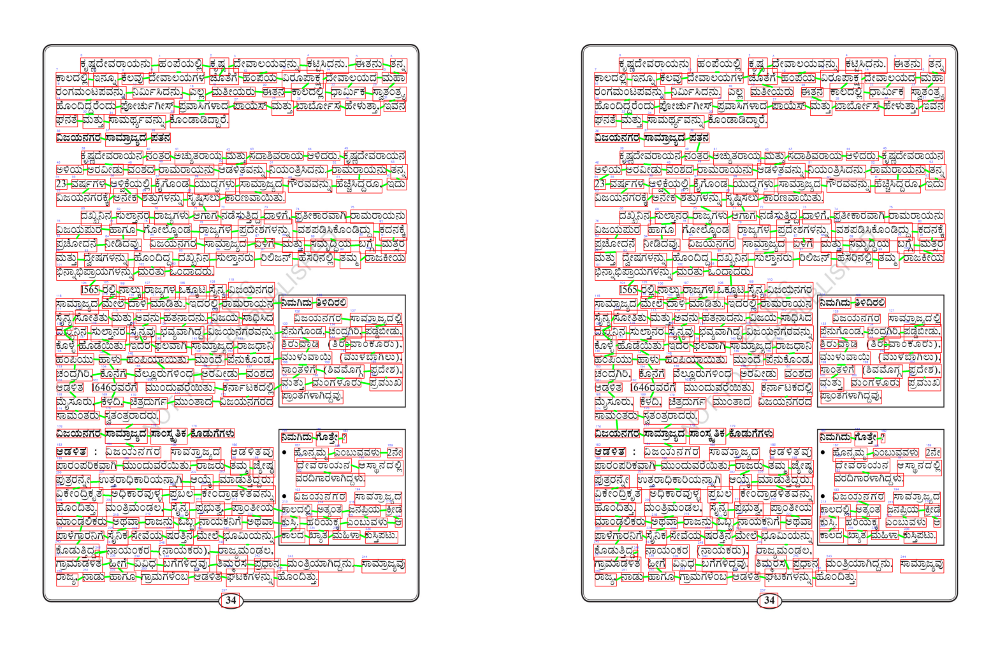

In [74]:
df = pd.read_csv('./Part-4/CSV/TLBR_145.csv')
# loading the image
img = cv2.imread('./Part-4/images/145.jpg')
# to calculate the 5 points of the bounding boxes (bottom-center, top-center, left-center, right-center, center)
df['Bottom'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Bottom-Right'].split(',')[1][:-1])], axis=1)
df['Top'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Top-Left'].split(',')[1][:-1])], axis=1)
df['Left'] = df.apply(lambda row: [int(row['Top-Left'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Right'] = df.apply(lambda row: [int(row['Bottom-Right'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Center'] = df.apply(lambda row: [(int(row['Top-Left'].split(',')[0][1:]) + int(row['Bottom-Right'].split(',')[0][1:]))/2.0, (int(row['Top-Left'].split(',')[1][:-1]) + int(row['Bottom-Right'].split(',')[1][:-1]))/2.0], axis=1)

plt.figure(figsize=(20, 20))

# for Assignment 2
threshold = 49

df = find_connections(df, vertical_threshold=threshold, horizontal_threshold = threshold)
plt.subplot(1, 2, 1)
plt.imshow(make_connections(img))
plt.axis("off")

# for this assignment 
kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(6, 7, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
kde_v.visualize(show_data = False)

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(3, 4, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
kde_h.visualize(show_data= False)

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.subplot(1, 2, 2)
plt.imshow(make_connections(img))
plt.axis("off")
# plt.show()

### IMAGE 201

C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

(-0.5, 2474.5, 3499.5, -0.5)

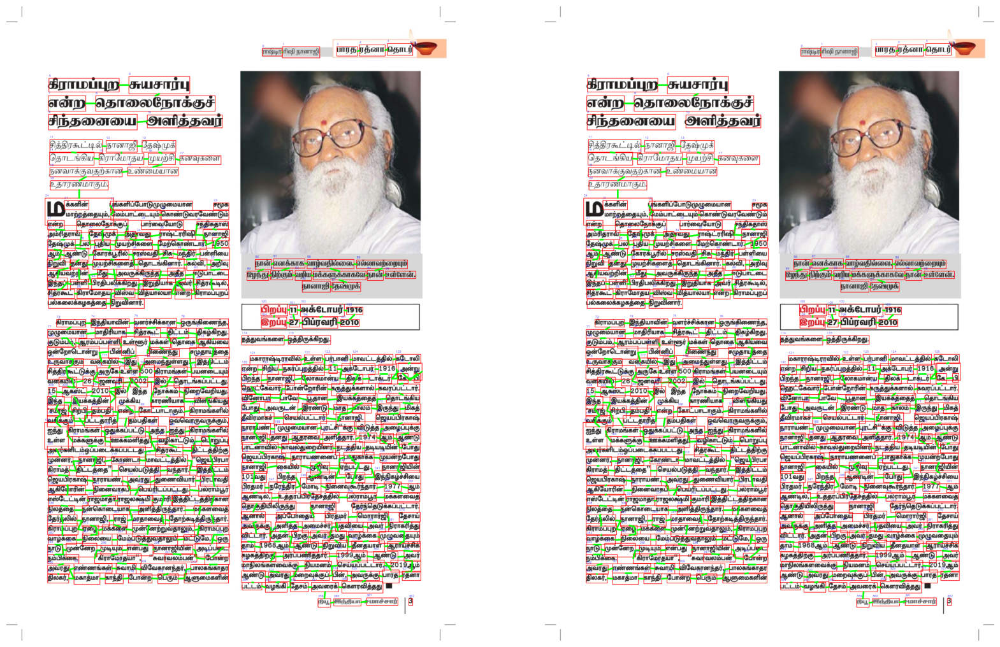

In [75]:
df = pd.read_csv('./Part-4/CSV/TLBR_201.csv')
# loading the image
img = cv2.imread('./Part-4/images/201.jpg')
# to calculate the 5 points of the bounding boxes (bottom-center, top-center, left-center, right-center, center)
df['Bottom'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Bottom-Right'].split(',')[1][:-1])], axis=1)
df['Top'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Top-Left'].split(',')[1][:-1])], axis=1)
df['Left'] = df.apply(lambda row: [int(row['Top-Left'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Right'] = df.apply(lambda row: [int(row['Bottom-Right'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Center'] = df.apply(lambda row: [(int(row['Top-Left'].split(',')[0][1:]) + int(row['Bottom-Right'].split(',')[0][1:]))/2.0, (int(row['Top-Left'].split(',')[1][:-1]) + int(row['Bottom-Right'].split(',')[1][:-1]))/2.0], axis=1)

plt.figure(figsize=(20, 20))

# for Assignment 2
threshold = 56.4

df = find_connections(df, vertical_threshold=threshold, horizontal_threshold = threshold)
plt.subplot(1, 2, 1)
plt.imshow(make_connections(img))
plt.axis("off")

# for this assignment 

# getting these values from above
vertical_threshold = 49.6
horizontal_threshold = 54.6

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.subplot(1, 2, 2)
plt.imshow(make_connections(img))
plt.axis("off")
# plt.show()

### IMAGE 232

C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

(-0.5, 2474.5, 3499.5, -0.5)

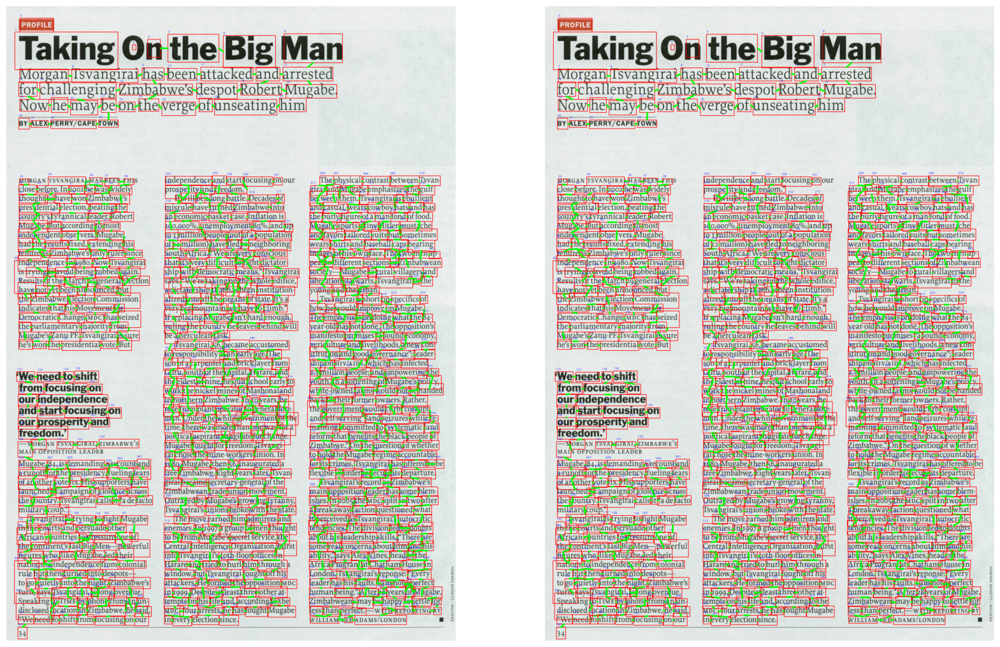

In [76]:
df = pd.read_csv('./Part-4/CSV/TLBR_232.csv')
# loading the image
img = cv2.imread('./Part-4/images/232.jpg')
# to calculate the 5 points of the bounding boxes (bottom-center, top-center, left-center, right-center, center)
df['Bottom'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Bottom-Right'].split(',')[1][:-1])], axis=1)
df['Top'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Top-Left'].split(',')[1][:-1])], axis=1)
df['Left'] = df.apply(lambda row: [int(row['Top-Left'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Right'] = df.apply(lambda row: [int(row['Bottom-Right'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Center'] = df.apply(lambda row: [(int(row['Top-Left'].split(',')[0][1:]) + int(row['Bottom-Right'].split(',')[0][1:]))/2.0, (int(row['Top-Left'].split(',')[1][:-1]) + int(row['Bottom-Right'].split(',')[1][:-1]))/2.0], axis=1)

plt.figure(figsize=(20, 20))

# for Assignment 2
threshold = 49

df = find_connections(df, vertical_threshold=threshold, horizontal_threshold = threshold)
plt.subplot(1, 2, 1)
plt.imshow(make_connections(img))
plt.axis("off")

# for this assignment 
kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(3, 4, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
kde_v.visualize(show_data = False)

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(3, 4, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
kde_h.visualize(show_data= False)

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.subplot(1, 2, 2)
plt.imshow(make_connections(img))
plt.axis("off")
# plt.show()

### IMAGE 250

C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Left_Box'].iloc[i] = [j, df['Id'].iloc[j]]
C:\Users\hp\AppData\Local\Temp\ipykernel_27524\3490718184.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Right_B

(-0.5, 2474.5, 3499.5, -0.5)

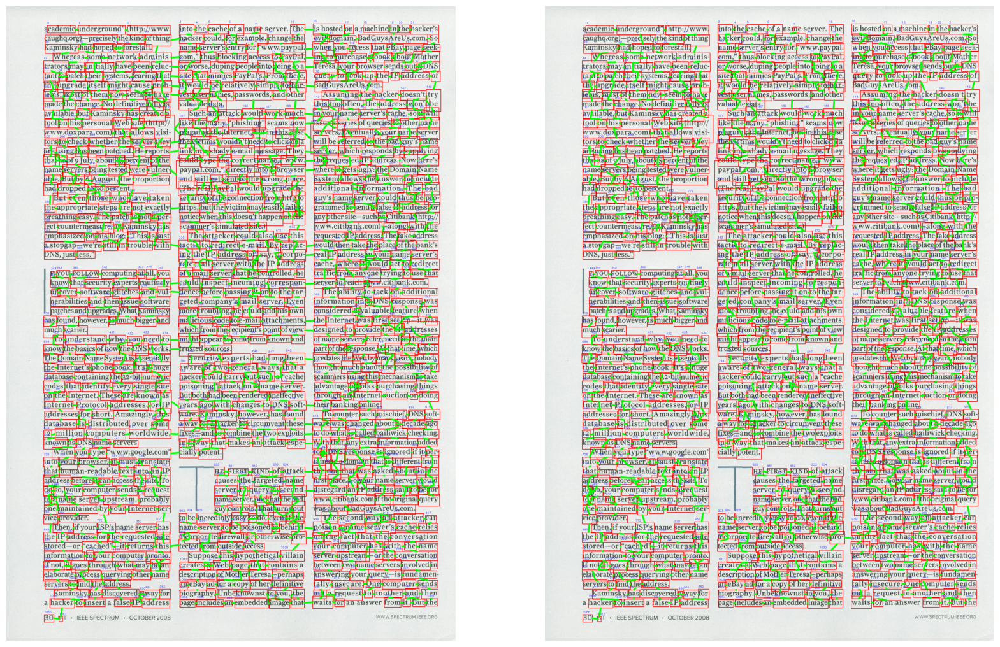

In [77]:
df = pd.read_csv('./Part-4/CSV/TLBR_250.csv')
# loading the image
img = cv2.imread('./Part-4/images/250.jpg')
# to calculate the 5 points of the bounding boxes (bottom-center, top-center, left-center, right-center, center)
df['Bottom'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Bottom-Right'].split(',')[1][:-1])], axis=1)
df['Top'] = df.apply(lambda row: [(int(row['Bottom-Right'].split(',')[0][1:])+int(row['Top-Left'].split(',')[0][1:]))/2, int(row['Top-Left'].split(',')[1][:-1])], axis=1)
df['Left'] = df.apply(lambda row: [int(row['Top-Left'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Right'] = df.apply(lambda row: [int(row['Bottom-Right'].split(',')[0][1:]), (int(row['Bottom-Right'].split(',')[1][:-1])+int(row['Top-Left'].split(',')[1][:-1]))/2], axis=1)
df['Center'] = df.apply(lambda row: [(int(row['Top-Left'].split(',')[0][1:]) + int(row['Bottom-Right'].split(',')[0][1:]))/2.0, (int(row['Top-Left'].split(',')[1][:-1]) + int(row['Bottom-Right'].split(',')[1][:-1]))/2.0], axis=1)

plt.figure(figsize=(20, 20))

# for Assignment 2
threshold = 49

df = find_connections(df, vertical_threshold=threshold, horizontal_threshold = threshold)
plt.subplot(1, 2, 1)
plt.imshow(make_connections(img))
plt.axis("off")

# for this assignment 
kde_v = KDE(kernel='gaussian', bandwidths=np.linspace(6, 7, 3))
kde_v.fit(data=distance_vertical.reshape(-1, 1))
kde_v.visualize(show_data = False)

kde_h = KDE(kernel='gaussian', bandwidths=np.linspace(3, 4, 3))
kde_h.fit(data=distance_horizontal.reshape(-1, 1))
kde_h.visualize(show_data= False)

density_v = kde_v.density_values
x_plot_v = kde_v.x_plot

max_density = np.max(density_v)
vertical_threshold = x_plot_v[np.max(np.where(density_v >= 0.5 * max_density)[0])]

density_h = kde_h.density_values
x_plot_h = kde_h.x_plot

max_density = np.max(density_h)
horizontal_threshold = x_plot_h[np.max(np.where(density_h >= 0.5 * max_density)[0])]

df = find_connections(df, vertical_threshold=vertical_threshold, horizontal_threshold = horizontal_threshold)
plt.subplot(1, 2, 2)
plt.imshow(make_connections(img))
plt.axis("off")
# plt.show()

We can see that the results are quite similar, but for image where the columns and paragraphs are close, KDE performs better. The main reason is we are find the horizontal and vertical threshold in KDE seperately, which wasn't the case for Assignment 2 implementation using Hierarchical Clustering.